In [1]:
%load_ext autoreload
%reload_ext tensorboard
%autoreload 2

In [2]:
import config
import torch
import torch.optim as optim

from model import s13Model, PrintCallback #YOLOv3
from tqdm import tqdm
from utils import (
    mean_average_precision,
    cells_to_bboxes,
    get_evaluation_bboxes,
    save_checkpoint,
    load_checkpoint,
    check_class_accuracy,
    get_loaders,
    plot_couple_examples
)
from loss import YoloLoss
import warnings
warnings.filterwarnings("ignore")
from pytorch_lightning import LightningModule, Trainer

In [3]:
AVAIL_GPUS = min(1, torch.cuda.device_count())
AVAIL_GPUS

1

Using 16bit Automatic Mixed Precision (AMP)
Trainer already configured with model summary callbacks: [<class 'pytorch_lightning.callbacks.model_summary.ModelSummary'>]. Skipping setting a default `ModelSummary` callback.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
Loading `train_dataloader` to estimate number of stepping batches.

    | Name                       | Type              | Params
-------------------------------------------------------------------
0   | loss_fn                    | YoloLoss          | 0     
1   | loss_fn.mse                | MSELoss           | 0     
2   | loss_fn.bce                | BCEWithLogitsLoss | 0     
3   | loss_fn.entropy            | CrossEntropyLoss  | 0     
4   | loss_fn.sigmoid            | Sigmoid           | 0     
5   | layers                     | ModuleList        | 61.6 M
6   | layers.

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

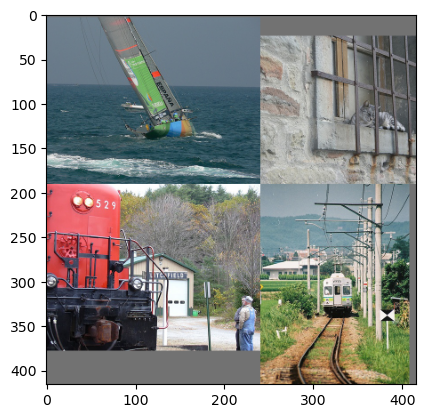

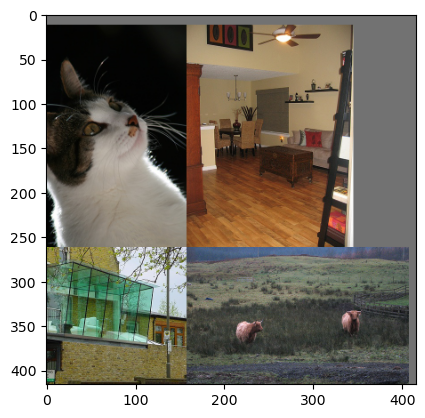

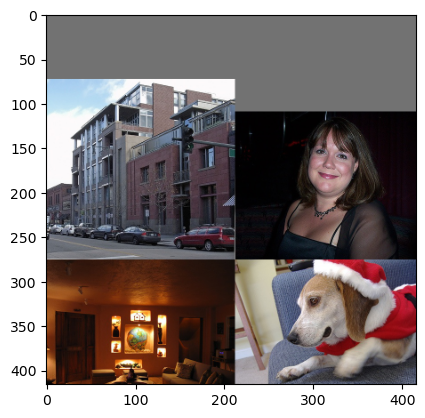

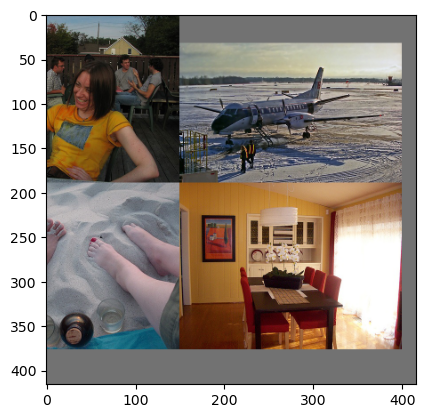

Validation: 0it [00:00, ?it/s]

Epoch: 0, Train Loss: 14.5319



 19%|███████▍                                | 193/1035 [00:29<01:58,  7.11it/s]


 37%|██████████████▉                         | 387/1035 [00:57<01:30,  7.18it/s]


 56%|██████████████████████▍                 | 581/1035 [01:25<01:08,  6.61it/s]


 75%|█████████████████████████████▉          | 775/1035 [01:53<00:53,  4.86it/s]


 94%|█████████████████████████████████████▍  | 969/1035 [02:21<00:09,  7.13it/s]


100%|███████████████████████████████████████| 1035/1035 [02:31<00:00,  6.84it/s]


Class accuracy is: 32.862946%
No obj accuracy is: 85.872208%
Obj accuracy is: 26.696379%


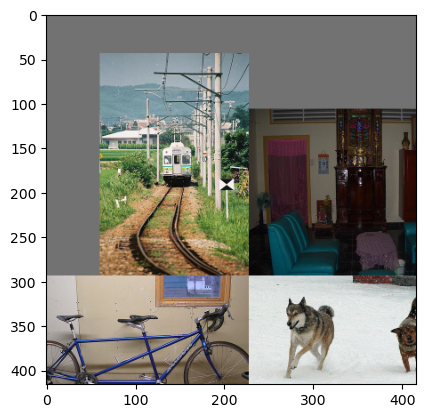

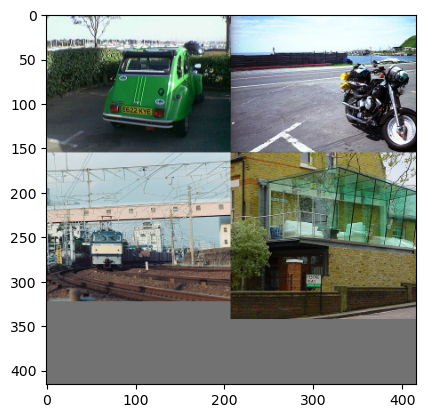

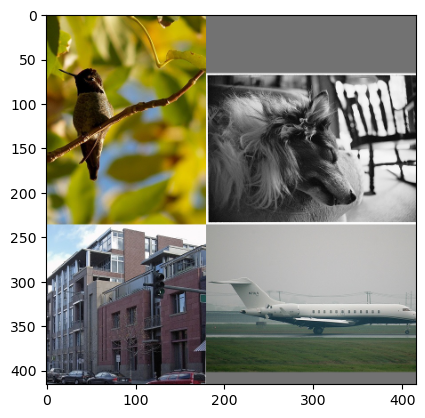

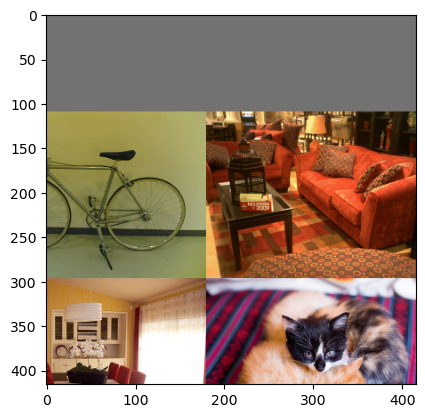

Validation: 0it [00:00, ?it/s]

Epoch: 1, Train Loss: 11.6637



 19%|███████▍                                | 193/1035 [00:28<01:58,  7.10it/s]


 37%|██████████████▉                         | 387/1035 [00:56<01:30,  7.16it/s]


 56%|██████████████████████▍                 | 581/1035 [01:25<01:07,  6.72it/s]


 75%|█████████████████████████████▉          | 775/1035 [01:53<00:37,  6.98it/s]


 94%|█████████████████████████████████████▍  | 969/1035 [02:21<00:09,  7.22it/s]


100%|███████████████████████████████████████| 1035/1035 [02:31<00:00,  6.84it/s]


Class accuracy is: 37.211533%
No obj accuracy is: 96.225563%
Obj accuracy is: 26.352873%


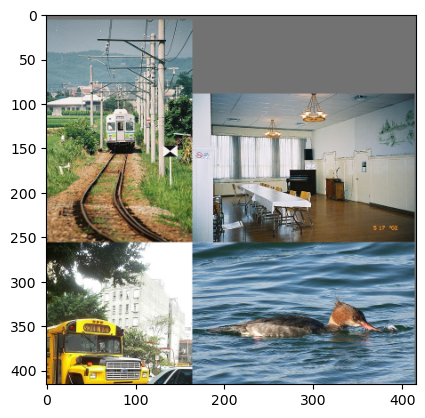

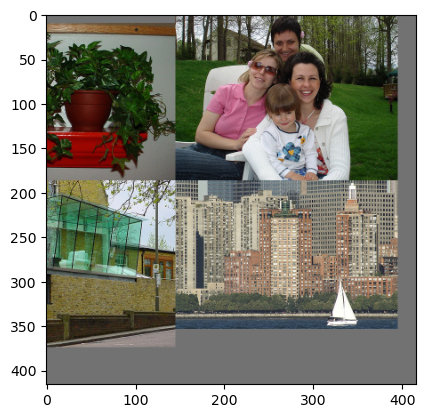

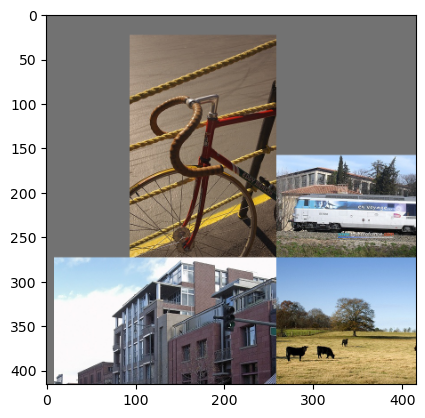

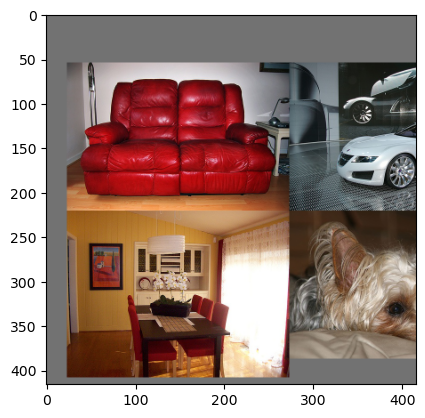

Validation: 0it [00:00, ?it/s]

Epoch: 2, Train Loss: 10.1888



 19%|███████▍                                | 193/1035 [00:29<02:06,  6.64it/s]


 37%|██████████████▉                         | 387/1035 [00:57<01:33,  6.95it/s]


 56%|██████████████████████▍                 | 581/1035 [01:25<01:06,  6.85it/s]


 75%|█████████████████████████████▉          | 775/1035 [01:53<00:37,  6.93it/s]


 94%|█████████████████████████████████████▍  | 969/1035 [02:21<00:10,  6.48it/s]


100%|███████████████████████████████████████| 1035/1035 [02:31<00:00,  6.84it/s]


Class accuracy is: 39.600780%
No obj accuracy is: 97.233925%
Obj accuracy is: 30.612272%


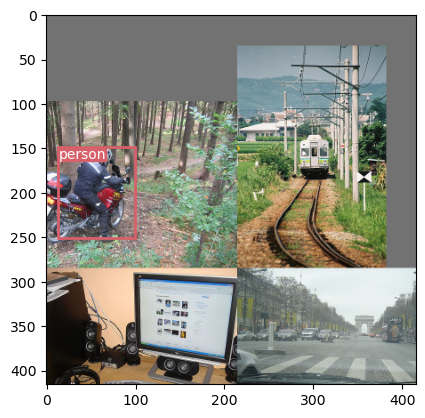

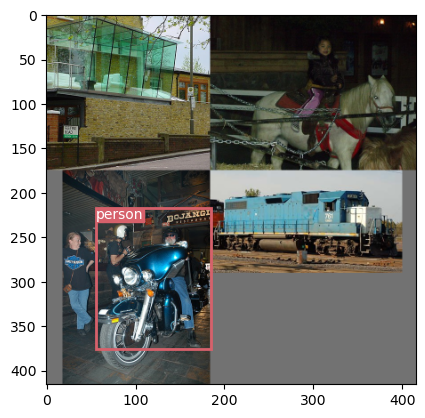

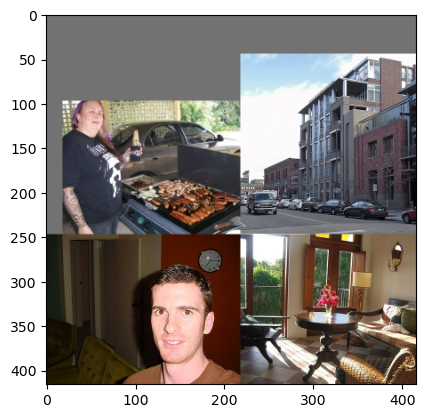

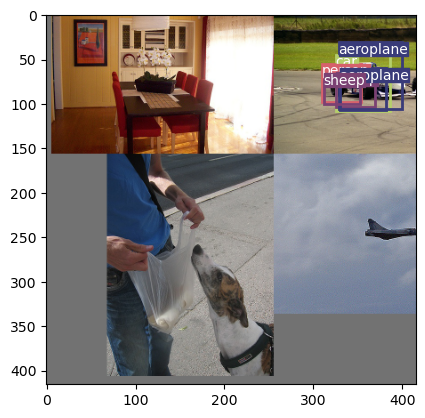

Validation: 0it [00:00, ?it/s]

Epoch: 3, Train Loss: 9.8087



 19%|███████▍                                | 193/1035 [00:28<01:58,  7.08it/s]


 37%|██████████████▉                         | 387/1035 [00:56<01:30,  7.13it/s]


 56%|██████████████████████▍                 | 581/1035 [01:24<01:01,  7.35it/s]


 75%|█████████████████████████████▉          | 775/1035 [01:53<00:36,  7.09it/s]


 94%|█████████████████████████████████████▍  | 969/1035 [02:20<00:09,  7.31it/s]


100%|███████████████████████████████████████| 1035/1035 [02:29<00:00,  6.91it/s]


Class accuracy is: 44.612698%
No obj accuracy is: 96.873978%
Obj accuracy is: 45.267628%


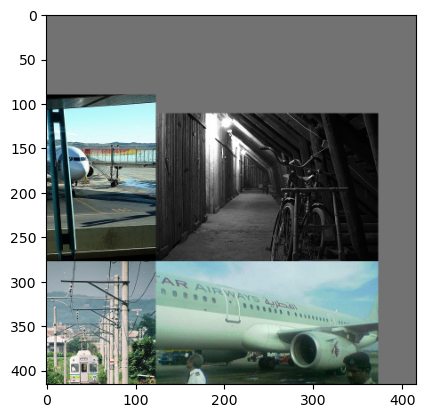

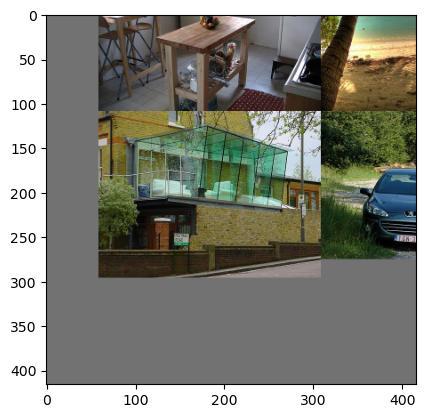

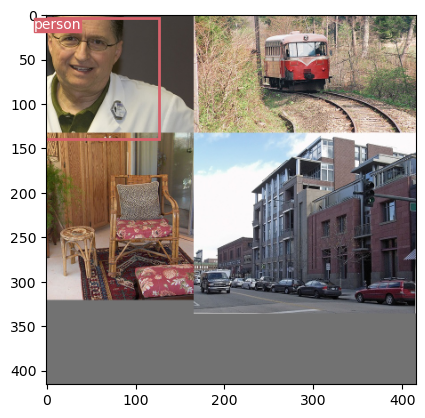

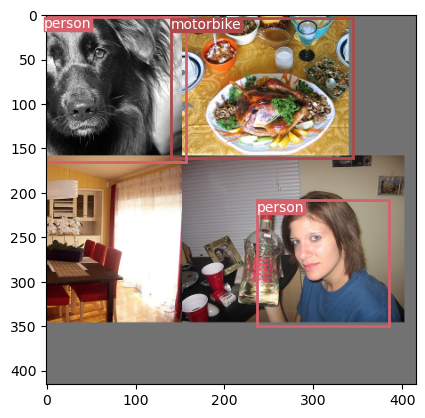

Validation: 0it [00:00, ?it/s]

Epoch: 4, Train Loss: 9.0019



 19%|███████▍                                | 193/1035 [00:28<02:01,  6.93it/s]


 37%|██████████████▉                         | 387/1035 [00:56<01:40,  6.46it/s]


 56%|██████████████████████▍                 | 581/1035 [01:25<01:04,  7.05it/s]


 75%|█████████████████████████████▉          | 775/1035 [01:53<00:39,  6.66it/s]


 94%|█████████████████████████████████████▍  | 969/1035 [02:21<00:09,  6.81it/s]


100%|███████████████████████████████████████| 1035/1035 [02:31<00:00,  6.85it/s]


Class accuracy is: 46.975090%
No obj accuracy is: 96.409721%
Obj accuracy is: 47.278648%


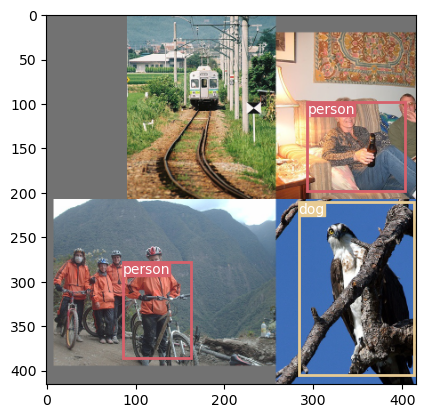

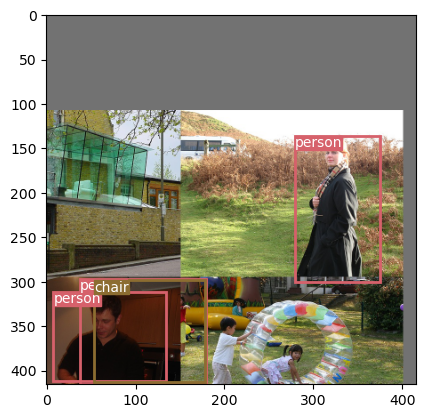

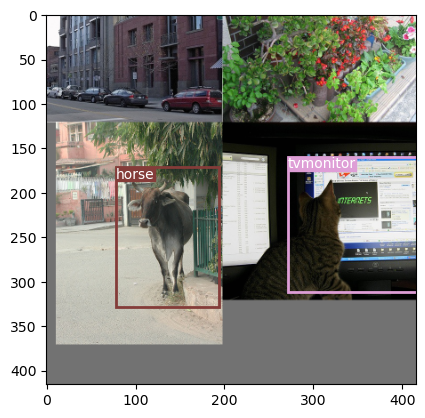

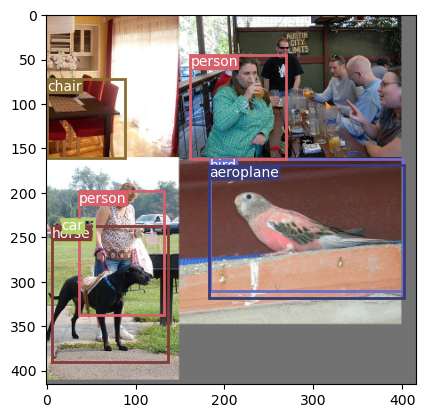

Validation: 0it [00:00, ?it/s]

Epoch: 5, Train Loss: 9.0314



 19%|███████▍                                | 193/1035 [00:28<01:54,  7.36it/s]


 37%|██████████████▉                         | 387/1035 [00:55<01:31,  7.10it/s]


 56%|██████████████████████▍                 | 581/1035 [01:24<01:03,  7.18it/s]


 75%|█████████████████████████████▉          | 775/1035 [01:51<00:35,  7.32it/s]


 94%|█████████████████████████████████████▍  | 969/1035 [02:19<00:09,  7.30it/s]


100%|███████████████████████████████████████| 1035/1035 [02:29<00:00,  6.92it/s]


Class accuracy is: 45.179317%
No obj accuracy is: 96.496910%
Obj accuracy is: 49.951878%



 62%|█████████████████████████▌               | 193/310 [00:26<00:15,  7.38it/s]


100%|█████████████████████████████████████████| 310/310 [00:42<00:00,  7.23it/s]


Class accuracy is: 51.297916%
No obj accuracy is: 96.182915%
Obj accuracy is: 48.614902%



 62%|█████████████████████████▌               | 193/310 [20:28<12:50,  6.58s/it]


100%|█████████████████████████████████████████| 310/310 [32:55<00:00,  6.37s/it]


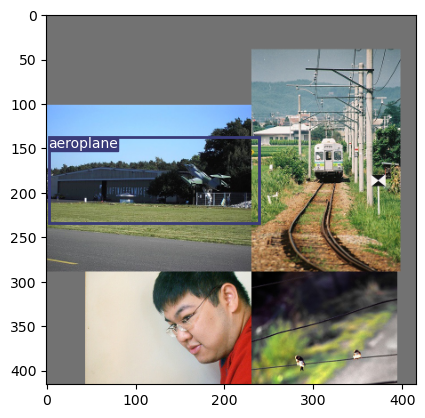

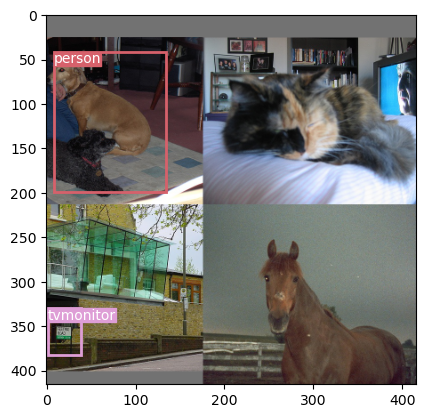

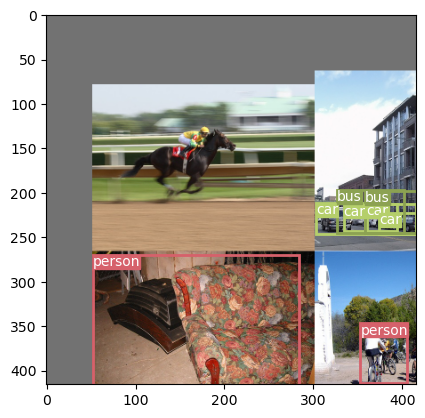

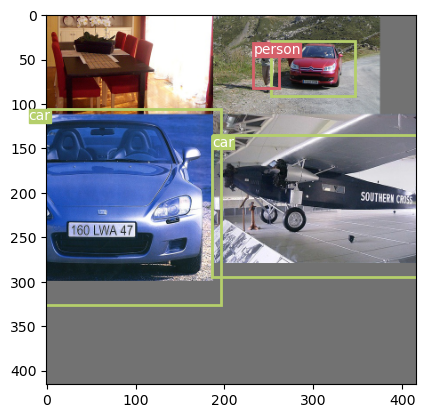

Validation: 0it [00:00, ?it/s]

Epoch: 6, Train Loss: 8.6710



 19%|███████▍                                | 193/1035 [00:28<01:58,  7.10it/s]


 37%|██████████████▉                         | 387/1035 [00:57<01:31,  7.10it/s]


 56%|██████████████████████▍                 | 581/1035 [01:25<01:01,  7.36it/s]


 75%|█████████████████████████████▉          | 775/1035 [01:52<00:35,  7.23it/s]


 94%|█████████████████████████████████████▍  | 969/1035 [02:20<00:09,  7.06it/s]


100%|███████████████████████████████████████| 1035/1035 [02:29<00:00,  6.91it/s]


Class accuracy is: 49.050053%
No obj accuracy is: 96.855370%
Obj accuracy is: 54.853691%


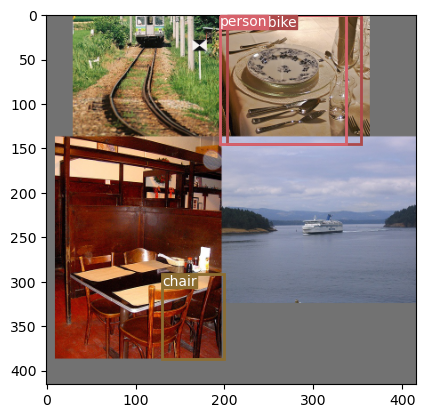

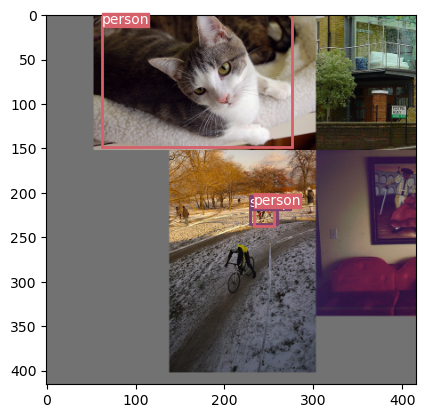

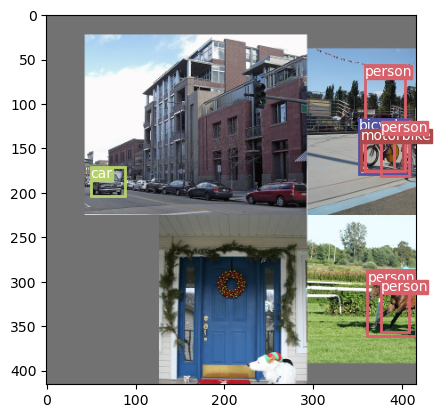

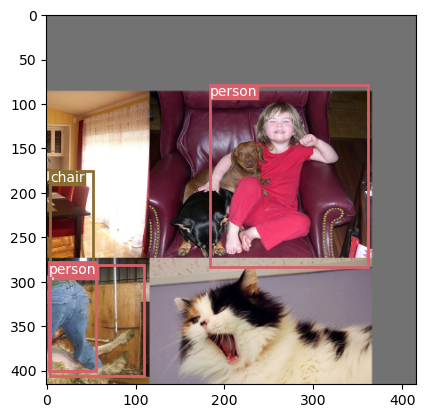

In [4]:
### This cell has training until the 6th epoch..Had to stop and restart in the next cell 
### to enable 75% only mosaic augmentations and some progress bar fix it stays in single line!

from pytorch_lightning.callbacks import ModelSummary
from pytorch_lightning.callbacks import LearningRateMonitor
lr_monitor = LearningRateMonitor(logging_interval='step')

max_epochs = 40
# model = s10Model(steps_per_epoch= len(train_loader), max_epochs=max_epochs)
model = s13Model(num_classes=config.NUM_CLASSES)

trainer = Trainer(
    callbacks=[ModelSummary(max_depth=-1), lr_monitor, PrintCallback()],
#     default_root_dir="/home/sn/ERAv1/checkpoints/",
    enable_checkpointing=True,
    precision=16,
    devices=AVAIL_GPUS, 
    max_epochs=max_epochs,
    log_every_n_steps=500
) 

train_loader, test_loader, train_eval_loader = get_loaders(
    train_csv_path=config.DATASET + "/train.csv", test_csv_path=config.DATASET + "/test.csv"
)

# if config.LOAD_MODEL:
#     load_checkpoint(
#         config.CHECKPOINT_FILE, model, optimizer, config.LEARNING_RATE
#     )

#,    enable_progress_bar=True)# progress_bar_refresh_rate=10)
#     gpus = AVAIL_GPUS,
#     max_epochs = 3,
#     progress_bar_refresh_rate=10
# )

trainer.fit(model, train_dataloaders=train_loader, val_dataloaders=test_loader)
#             ckpt_path="/ERAv1/session13_assignment/lightning_logs/version18/checkpoints/epoch=0-step=1035.ckpt")

In [7]:
### Reset the Model/trainer so that the training can pick up from a saved checkpoint file (6th epoch model)

from pytorch_lightning.callbacks import ModelSummary
from pytorch_lightning.callbacks import LearningRateMonitor
lr_monitor = LearningRateMonitor(logging_interval='step')

max_epochs = 40
# model = s10Model(steps_per_epoch= len(train_loader), max_epochs=max_epochs)
model = s13Model(num_classes=config.NUM_CLASSES)

trainer = Trainer(
    callbacks=[ModelSummary(max_depth=-1), lr_monitor, PrintCallback()],
#     default_root_dir="/home/sn/ERAv1/checkpoints/",
    enable_checkpointing=True,
    precision=16,
    devices=AVAIL_GPUS, 
    max_epochs=max_epochs,
    log_every_n_steps=500
) 

train_loader, test_loader, train_eval_loader = get_loaders(
    train_csv_path=config.DATASET + "/train.csv", test_csv_path=config.DATASET + "/test.csv"
)

Using 16bit Automatic Mixed Precision (AMP)
Trainer already configured with model summary callbacks: [<class 'pytorch_lightning.callbacks.model_summary.ModelSummary'>]. Skipping setting a default `ModelSummary` callback.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Restoring states from the checkpoint path at initial_s13Model.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
Loading `train_dataloader` to estimate number of stepping batches.

    | Name                       | Type              | Params
-------------------------------------------------------------------
0   | loss_fn                    | YoloLoss          | 0     
1   | loss_fn.mse                | MSELoss           | 0     
2   | loss_fn.bce                | BCEWithLogitsLoss | 0     
3   | loss_fn.entropy            | CrossEntropyLoss  | 0     
4   | loss_fn.sigmoid            | Sigmoid           | 0     
5   | layers                     | ModuleList        | 61.6 M
6   | layers.0                   | CNNBlock          | 928   
7   | layers.0.conv              | Conv2d            | 864   
8   | layers.0.bn                | BatchNorm2d       | 64    
9   | layers.0.leaky             | LeakyReLU         | 0     
10  | layers.1                   | CNNBlock          | 18.6 K
11  | lay

Restored all states from the checkpoint at initial_s13Model.ckpt


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

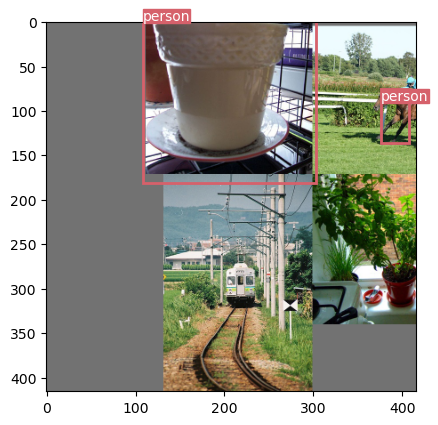

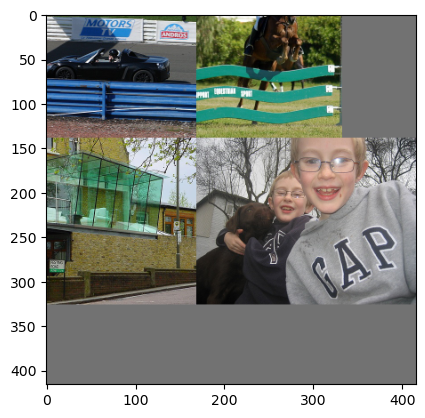

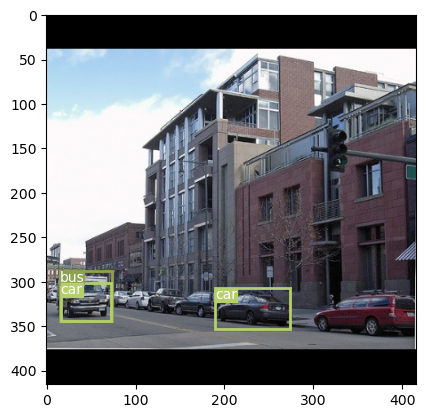

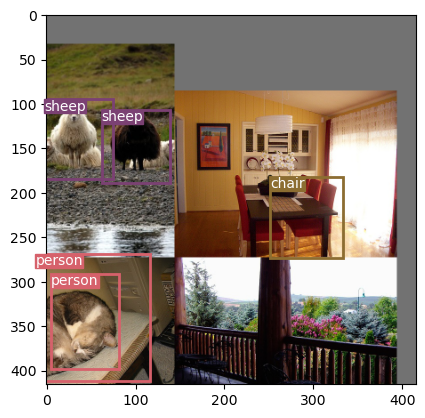

Validation: 0it [00:00, ?it/s]

Epoch: 7, Train Loss: 8.4121


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 53.238277%
No obj accuracy is: 97.597008%
Obj accuracy is: 49.062595%
Creating Checkpoint..


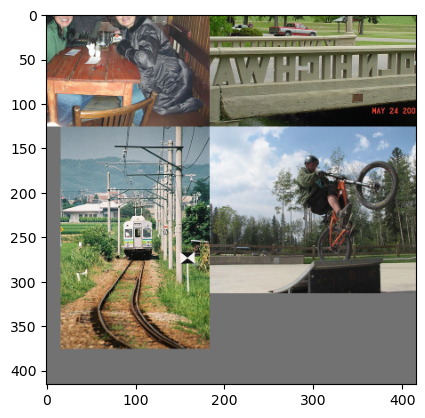

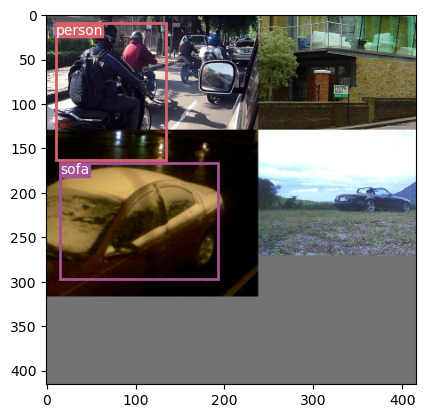

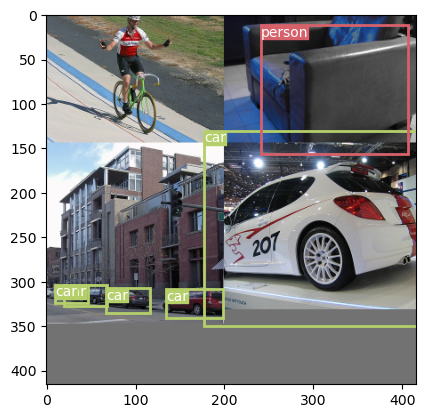

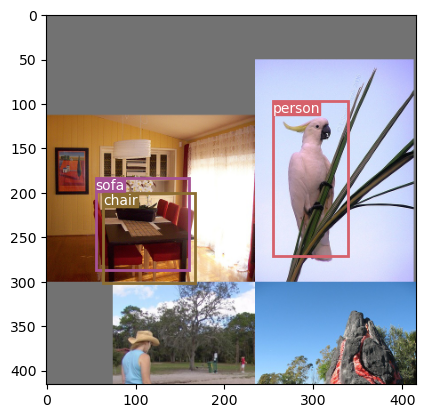

Validation: 0it [00:00, ?it/s]

Epoch: 8, Train Loss: 8.0012


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 50.085999%
No obj accuracy is: 97.896370%
Obj accuracy is: 50.159027%
Creating Checkpoint..


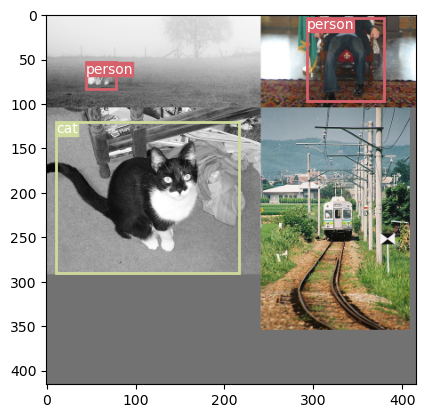

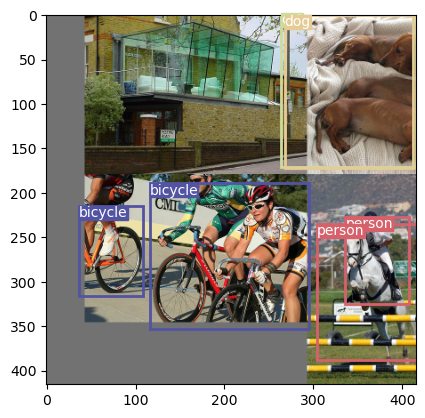

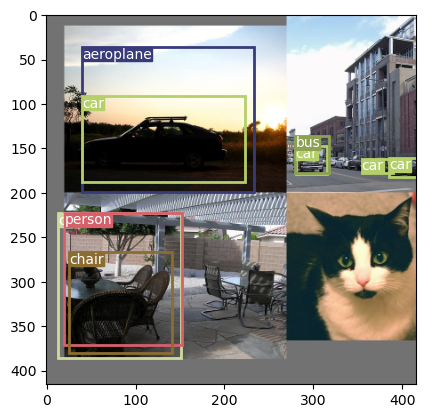

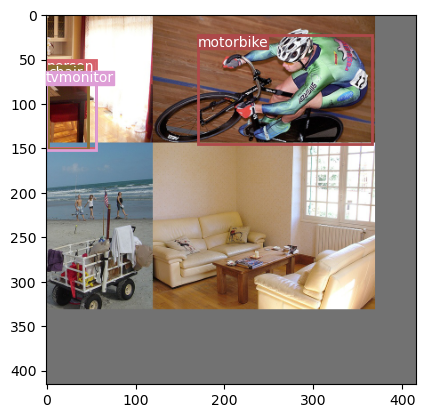

Validation: 0it [00:00, ?it/s]

Epoch: 9, Train Loss: 9.3777


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 52.363449%
No obj accuracy is: 97.966599%
Obj accuracy is: 51.706707%
Creating Checkpoint..


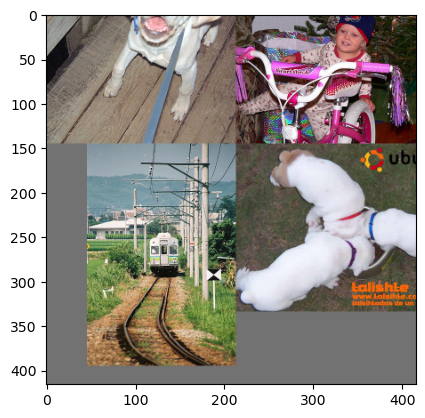

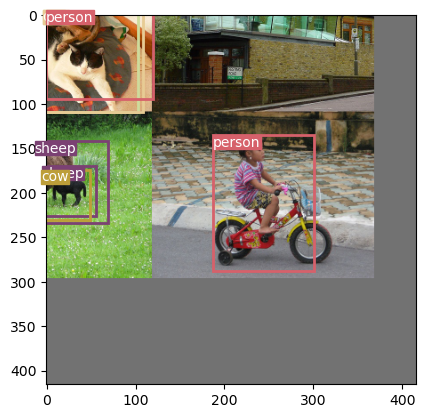

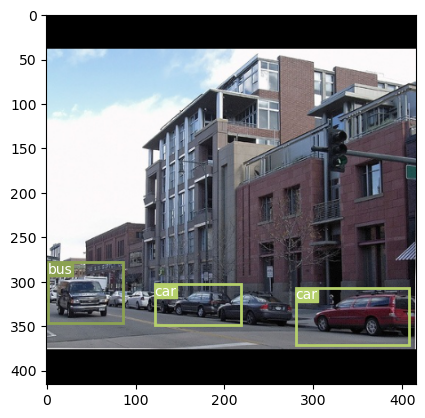

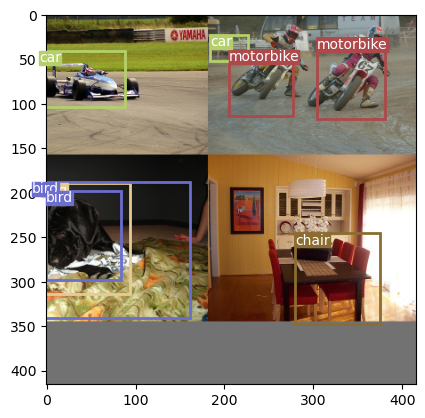

Validation: 0it [00:00, ?it/s]

Epoch: 10, Train Loss: 10.5603


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 55.670708%
No obj accuracy is: 97.324165%
Obj accuracy is: 55.702793%
Validation Loss: 9.6011


  0%|          | 0/310 [00:00<?, ?it/s]

Class accuracy is: 59.014957%
No obj accuracy is: 97.050522%
Obj accuracy is: 56.332882%
Creating Checkpoint..


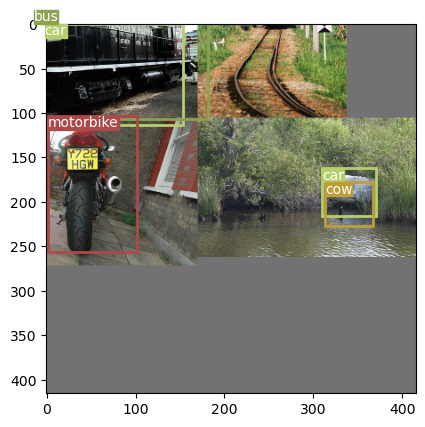

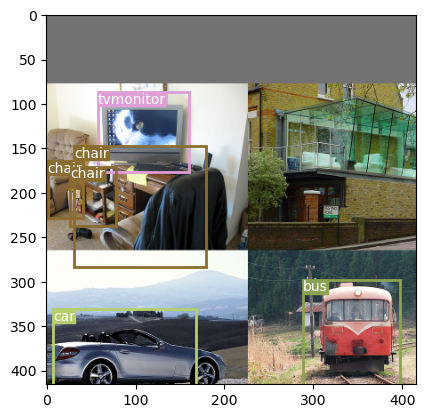

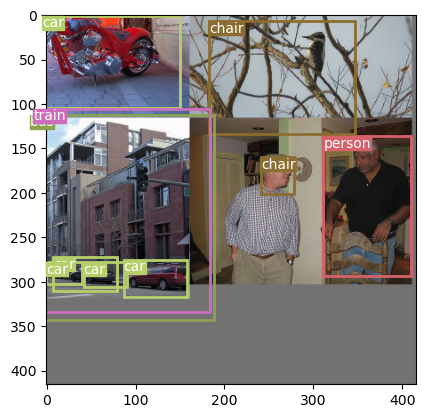

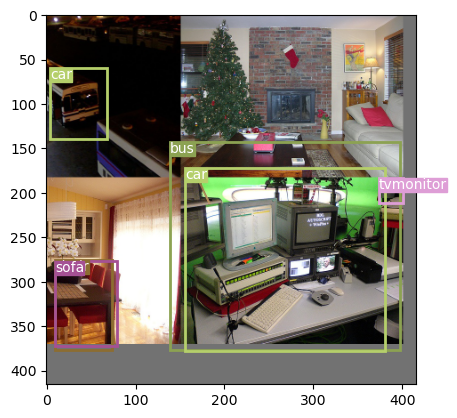

Validation: 0it [00:00, ?it/s]

Epoch: 11, Train Loss: 7.1236


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 51.742268%
No obj accuracy is: 96.268921%
Obj accuracy is: 62.502567%
Creating Checkpoint..


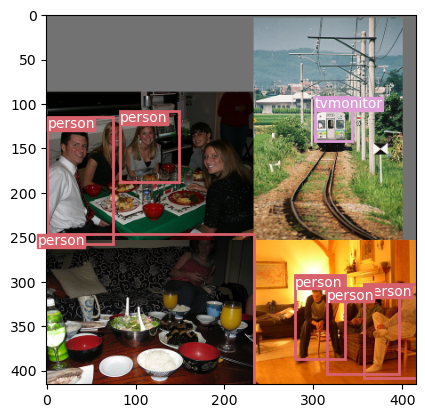

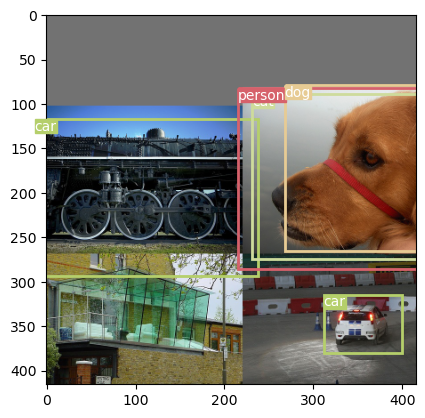

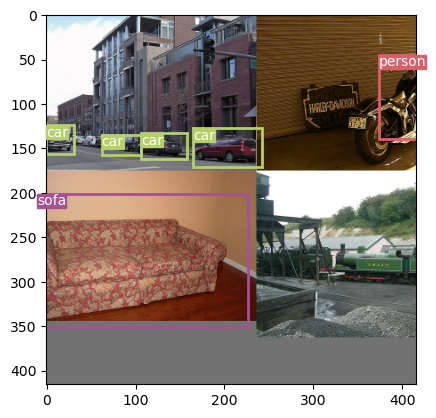

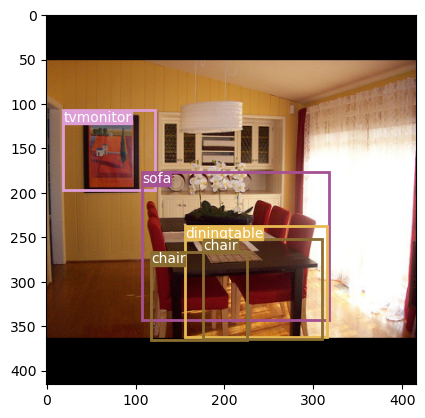

Validation: 0it [00:00, ?it/s]

Epoch: 12, Train Loss: 7.0782


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 58.373920%
No obj accuracy is: 97.456039%
Obj accuracy is: 61.257751%
Creating Checkpoint..


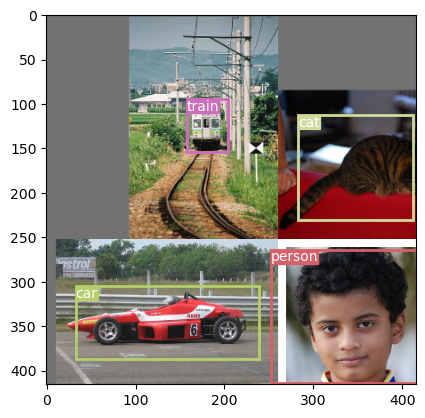

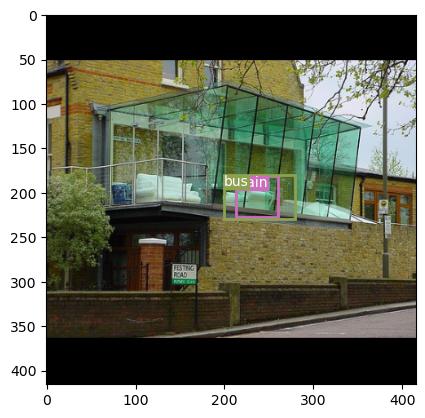

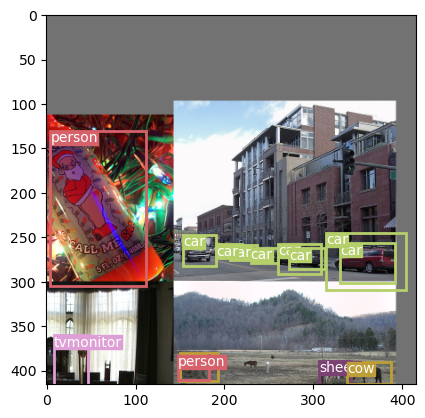

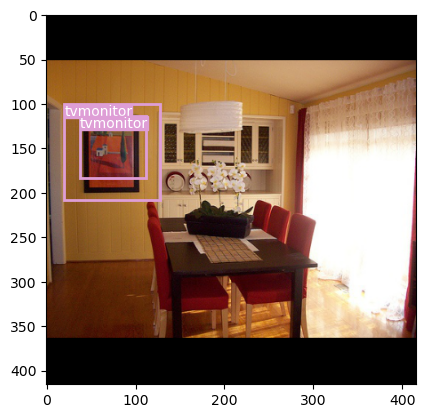

Validation: 0it [00:00, ?it/s]

Epoch: 13, Train Loss: 7.6216


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 59.826176%
No obj accuracy is: 96.802711%
Obj accuracy is: 65.200684%
Creating Checkpoint..


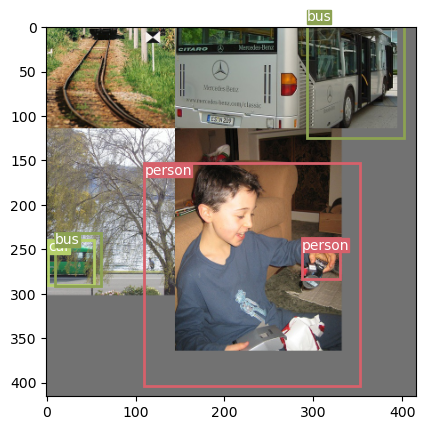

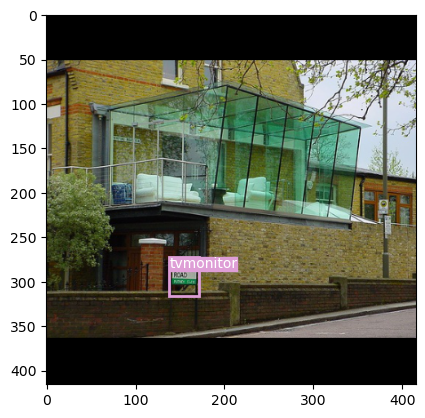

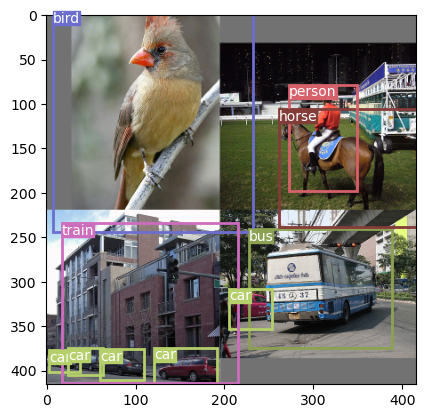

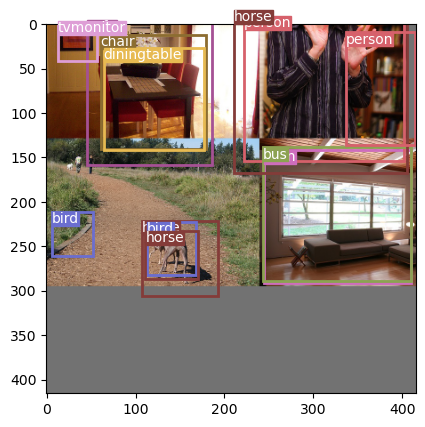

Validation: 0it [00:00, ?it/s]

Epoch: 14, Train Loss: 7.0240


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 60.692955%
No obj accuracy is: 97.279808%
Obj accuracy is: 63.298618%
Creating Checkpoint..


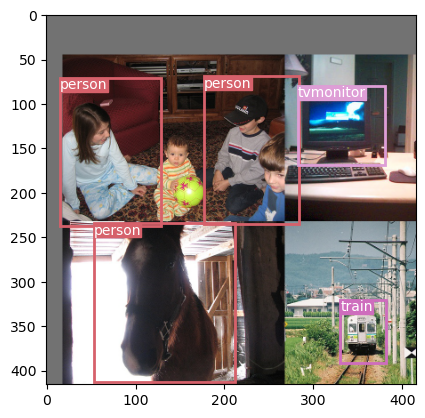

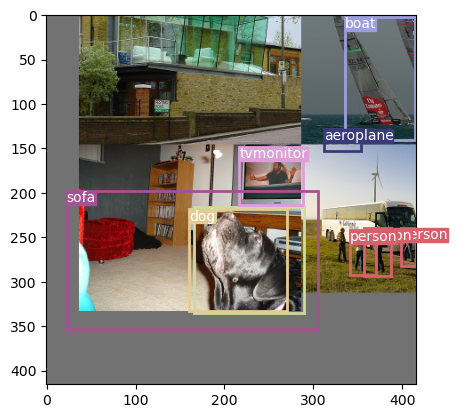

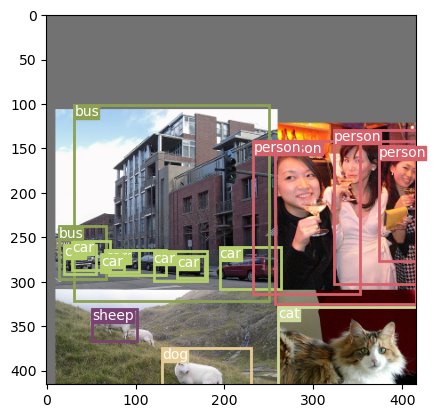

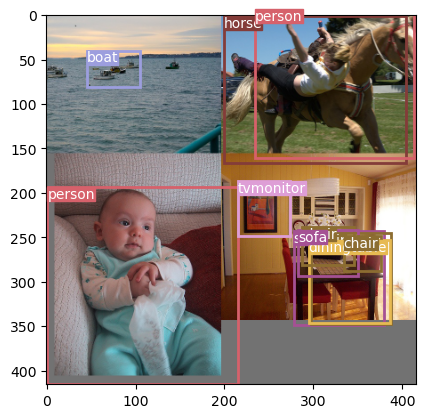

Validation: 0it [00:00, ?it/s]

Epoch: 15, Train Loss: 5.1296


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 62.244953%
No obj accuracy is: 97.142067%
Obj accuracy is: 66.332695%
Validation Loss: 7.6520


  0%|          | 0/310 [00:00<?, ?it/s]

Class accuracy is: 69.321144%
No obj accuracy is: 96.956268%
Obj accuracy is: 67.095085%
Creating Checkpoint..


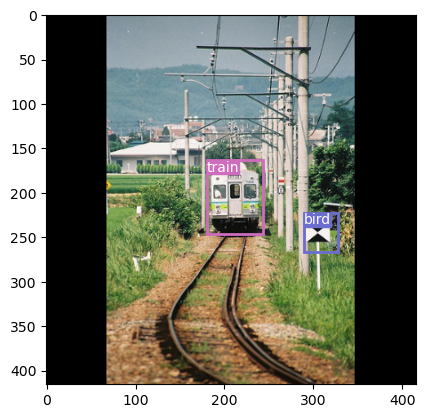

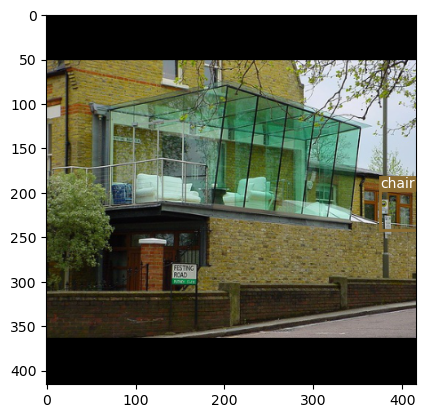

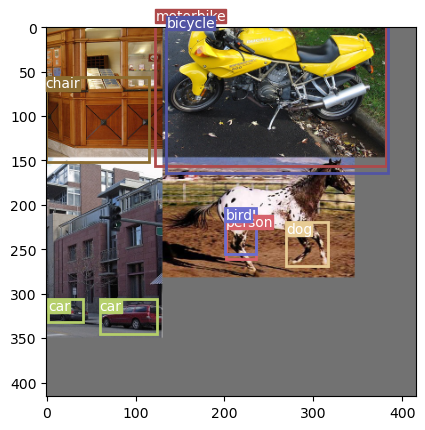

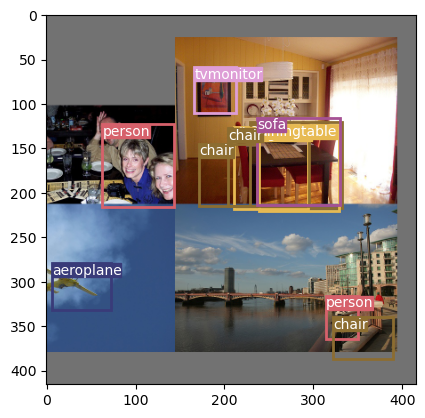

Validation: 0it [00:00, ?it/s]

Epoch: 16, Train Loss: 6.6167


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 64.365273%
No obj accuracy is: 97.965134%
Obj accuracy is: 61.320789%
Creating Checkpoint..


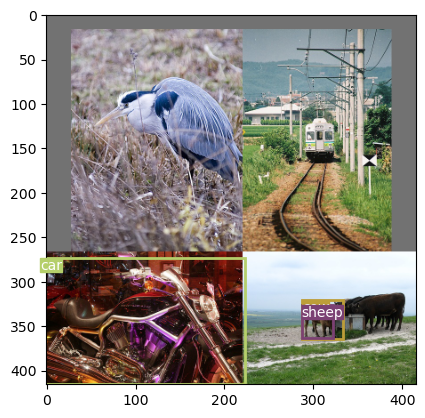

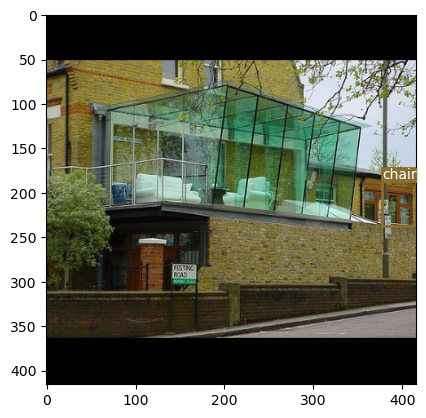

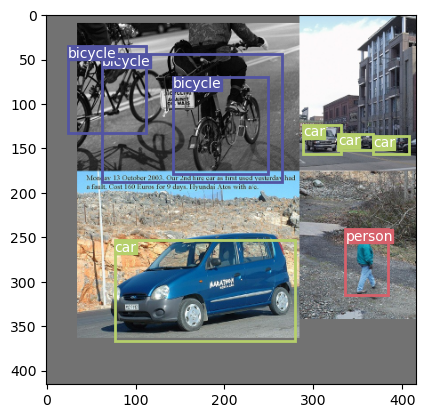

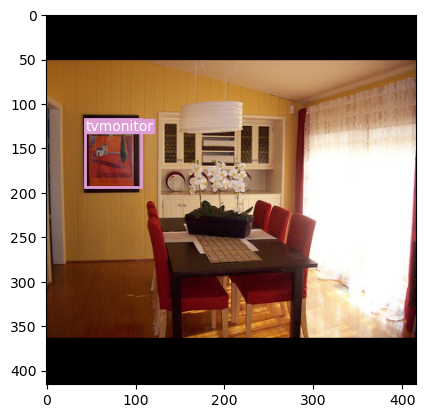

Validation: 0it [00:00, ?it/s]

Epoch: 17, Train Loss: 8.7583


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 67.561699%
No obj accuracy is: 97.499557%
Obj accuracy is: 67.624924%
Creating Checkpoint..


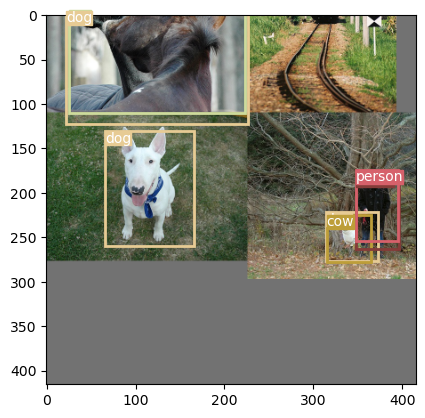

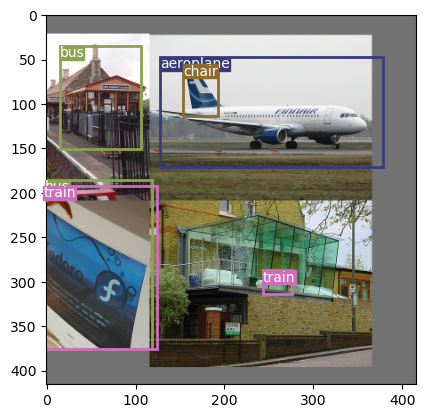

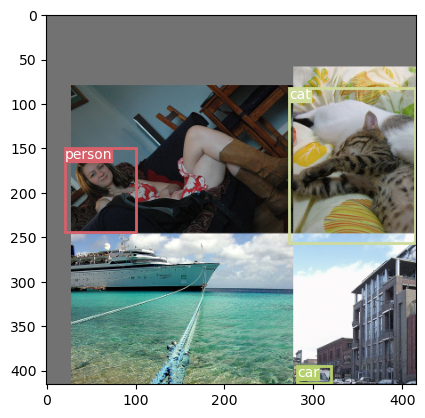

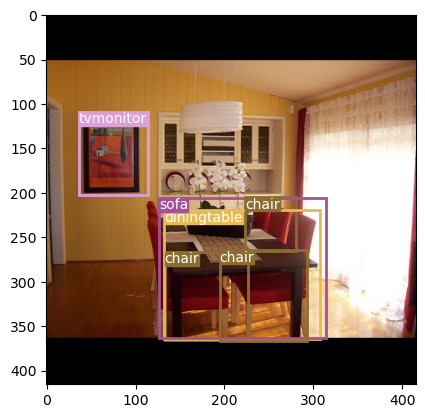

Validation: 0it [00:00, ?it/s]

Epoch: 18, Train Loss: 6.2042


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 66.855682%
No obj accuracy is: 97.977760%
Obj accuracy is: 66.184181%
Creating Checkpoint..


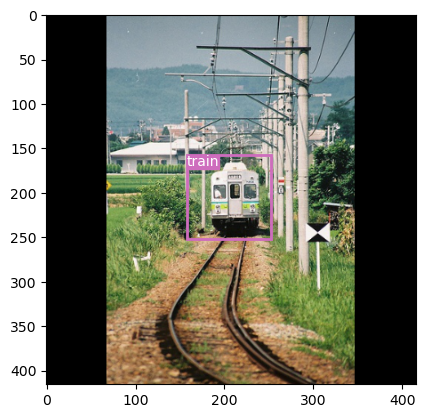

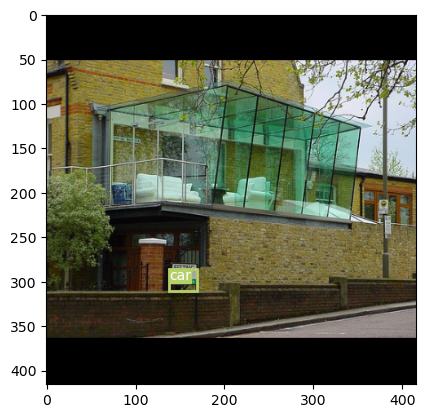

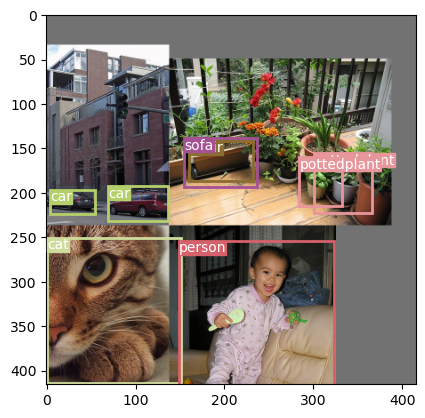

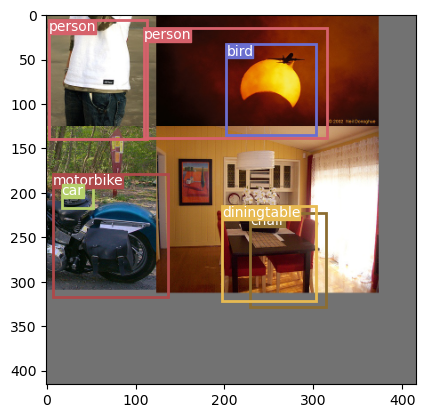

Validation: 0it [00:00, ?it/s]

Epoch: 19, Train Loss: 5.1105


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 68.193245%
No obj accuracy is: 97.782654%
Obj accuracy is: 67.347656%
Creating Checkpoint..


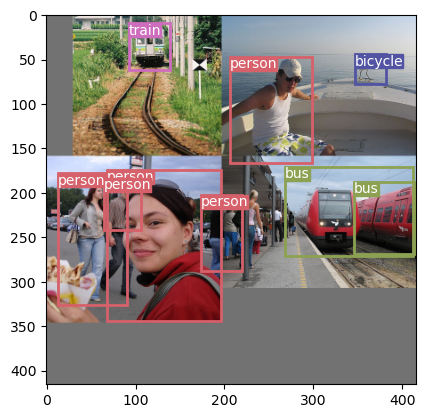

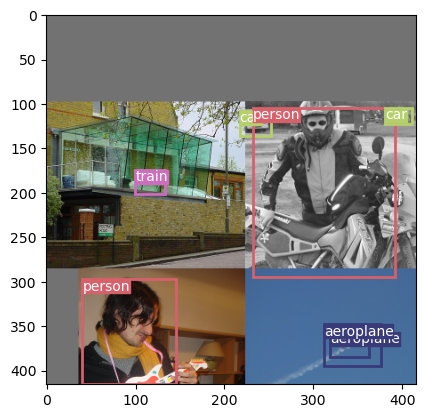

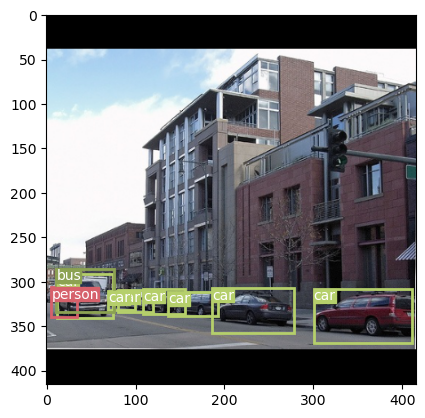

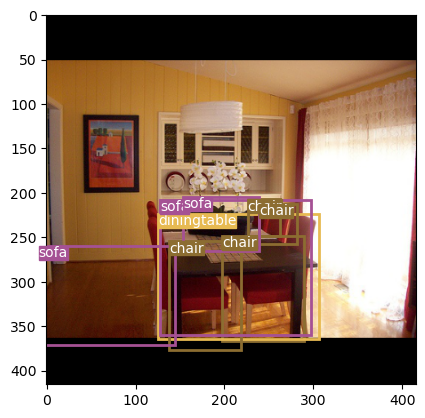

Validation: 0it [00:00, ?it/s]

Epoch: 20, Train Loss: 5.0563


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 68.975571%
No obj accuracy is: 97.963463%
Obj accuracy is: 67.096336%
Validation Loss: 6.8812


  0%|          | 0/310 [00:00<?, ?it/s]

Class accuracy is: 74.635086%
No obj accuracy is: 97.814163%
Obj accuracy is: 68.069557%
Creating Checkpoint..


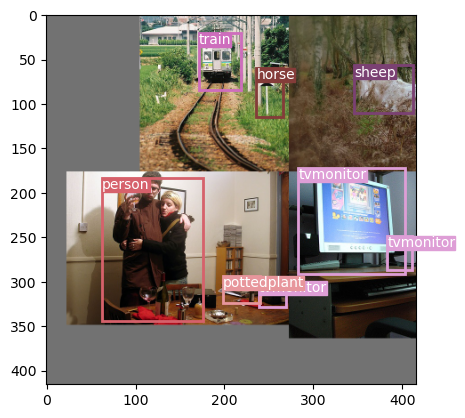

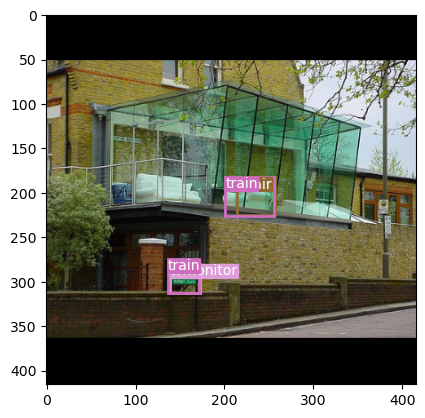

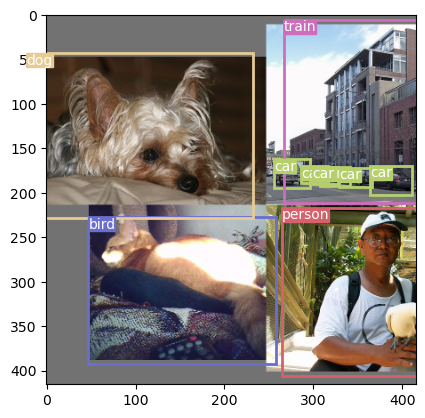

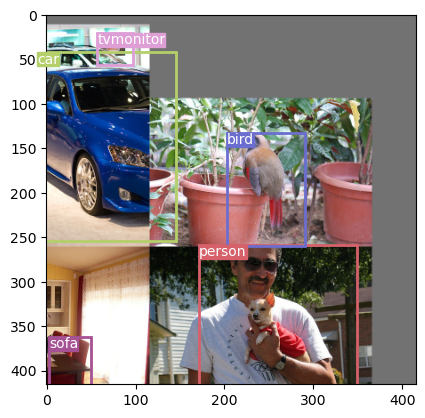

Validation: 0it [00:00, ?it/s]

Epoch: 21, Train Loss: 6.3658


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 68.728180%
No obj accuracy is: 97.628090%
Obj accuracy is: 69.400192%
Creating Checkpoint..


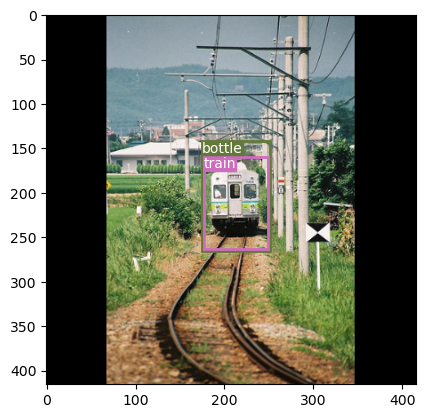

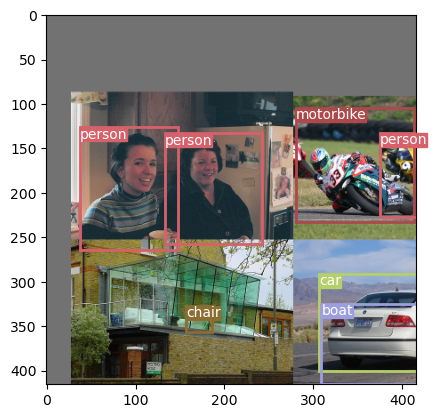

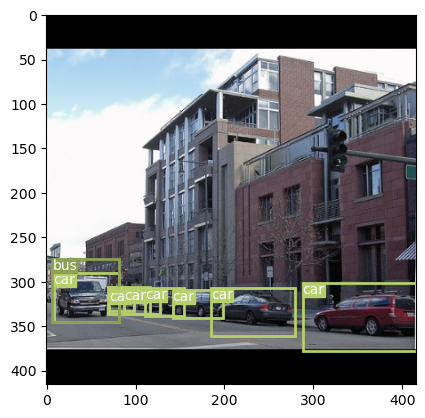

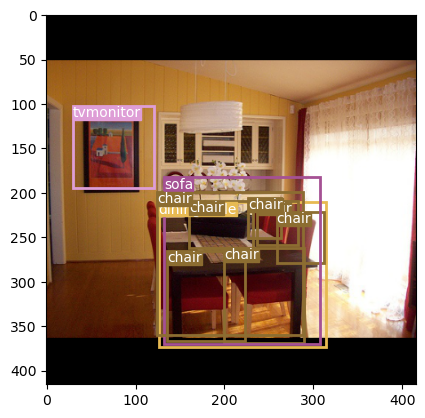

Validation: 0it [00:00, ?it/s]

Epoch: 22, Train Loss: 4.5849


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 72.517197%
No obj accuracy is: 97.977600%
Obj accuracy is: 68.809448%
Creating Checkpoint..


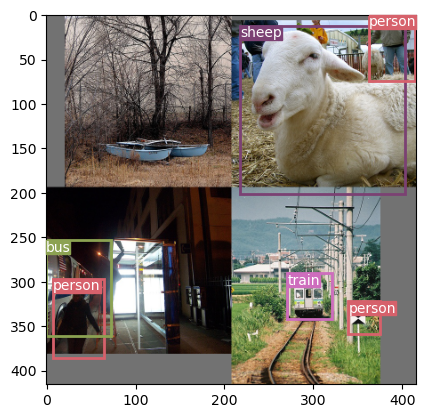

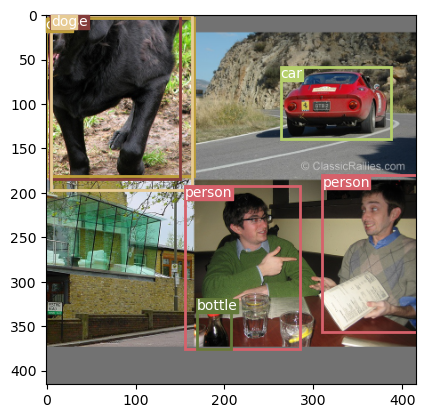

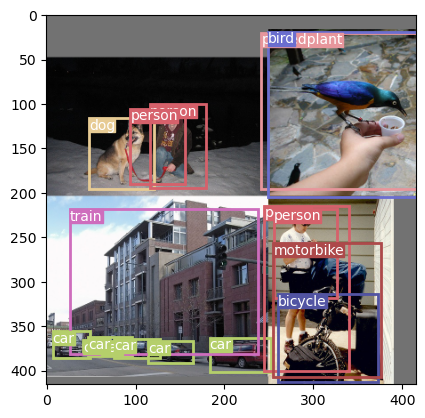

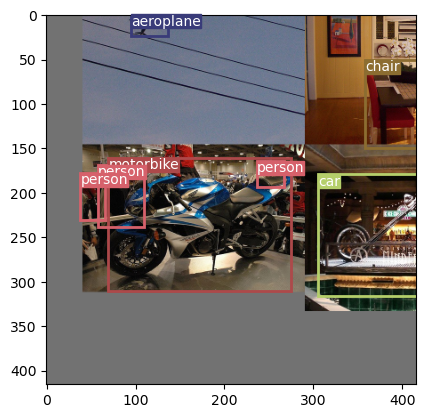

Validation: 0it [00:00, ?it/s]

Epoch: 23, Train Loss: 5.6005


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 72.983765%
No obj accuracy is: 97.597122%
Obj accuracy is: 71.315140%
Creating Checkpoint..


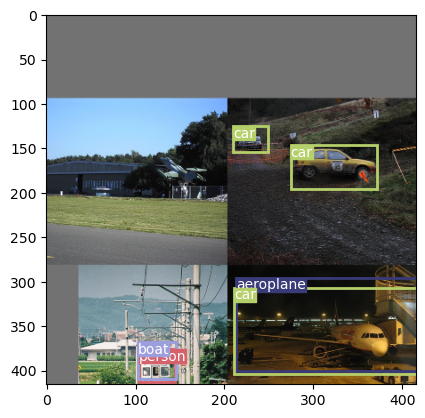

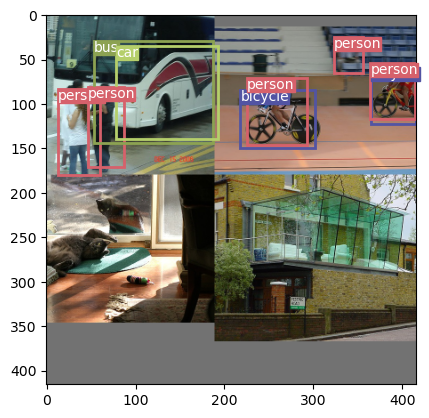

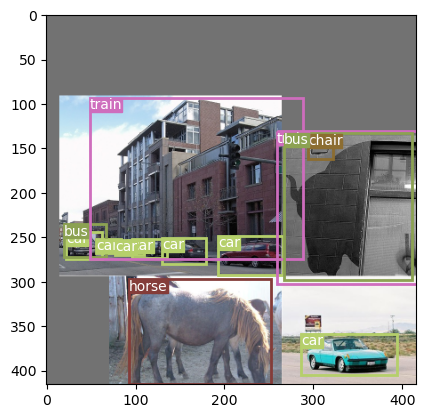

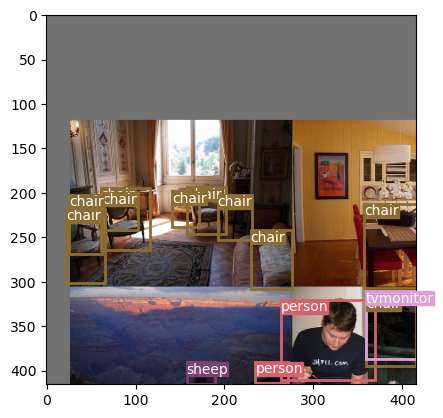

Validation: 0it [00:00, ?it/s]

Epoch: 24, Train Loss: 5.6758


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 72.203239%
No obj accuracy is: 97.845673%
Obj accuracy is: 69.979401%
Creating Checkpoint..


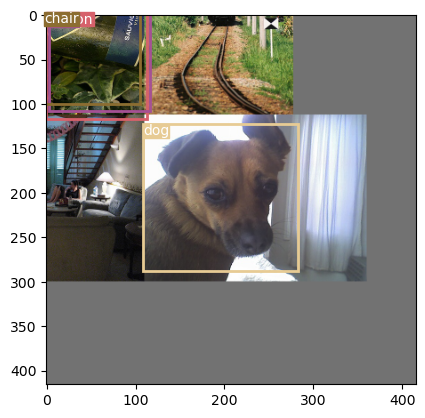

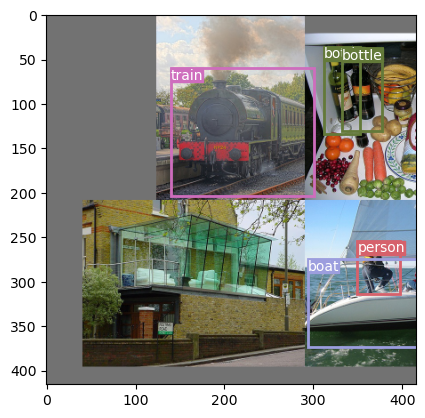

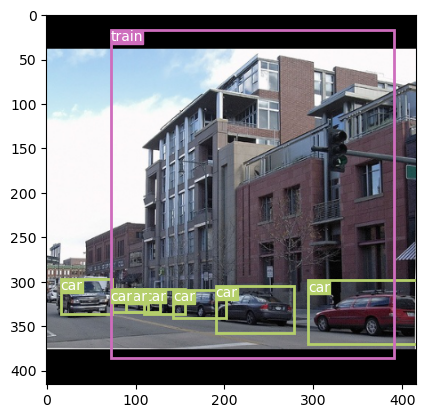

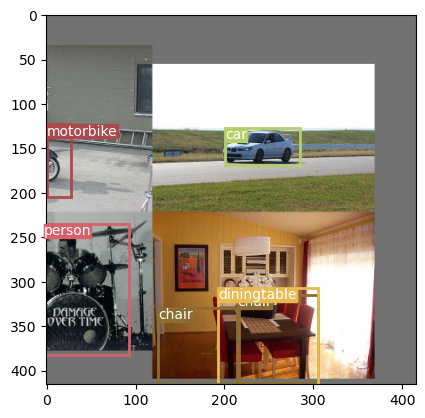

Validation: 0it [00:00, ?it/s]

Epoch: 25, Train Loss: 5.2450


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 74.215843%
No obj accuracy is: 97.706215%
Obj accuracy is: 73.226776%
Validation Loss: 7.3248


  0%|          | 0/310 [00:00<?, ?it/s]

Class accuracy is: 76.821892%
No obj accuracy is: 97.659973%
Obj accuracy is: 71.394958%
Creating Checkpoint..


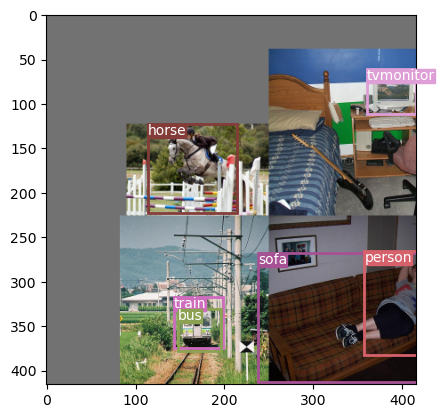

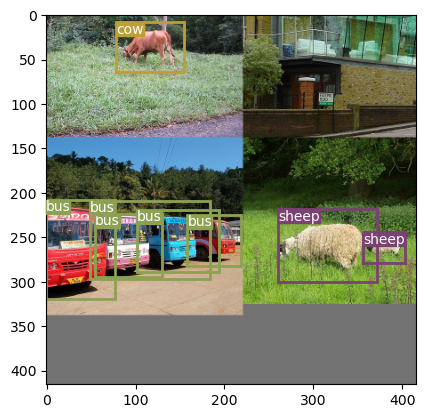

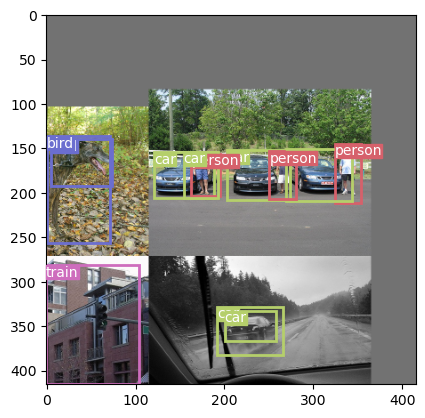

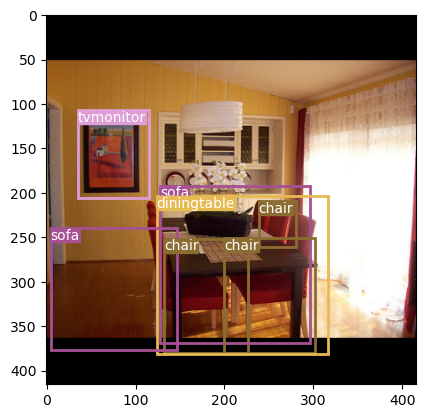

Validation: 0it [00:00, ?it/s]

Epoch: 26, Train Loss: 4.3976


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 75.378555%
No obj accuracy is: 98.045708%
Obj accuracy is: 70.424049%
Creating Checkpoint..


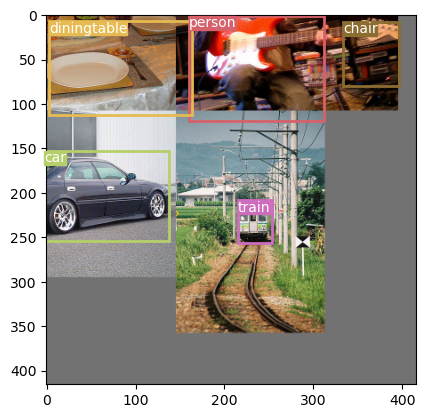

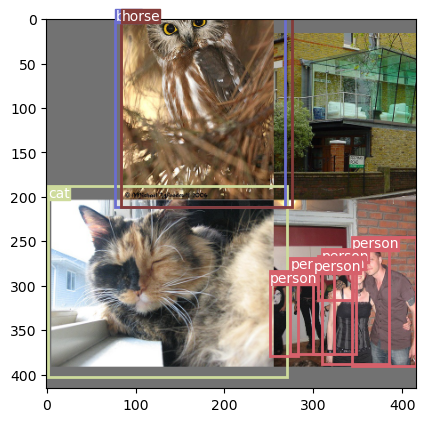

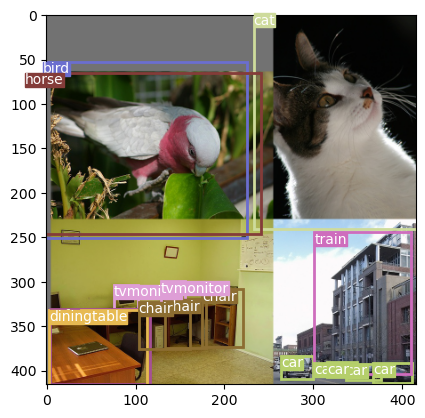

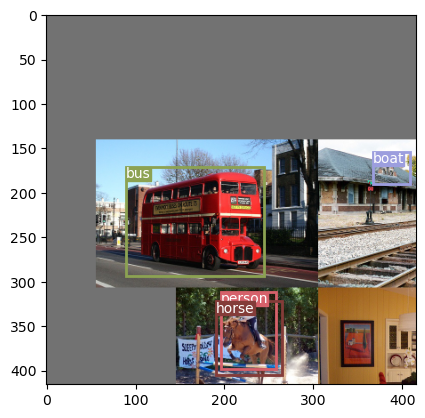

Validation: 0it [00:00, ?it/s]

Epoch: 27, Train Loss: 4.5583


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 76.739952%
No obj accuracy is: 98.068687%
Obj accuracy is: 71.518112%
Creating Checkpoint..


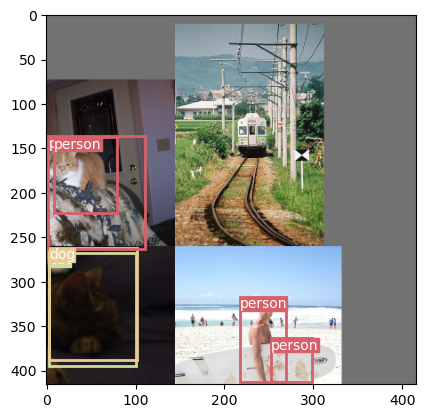

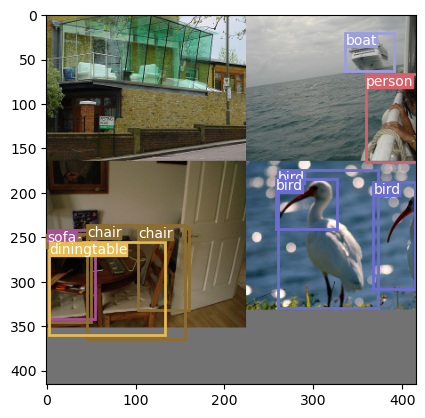

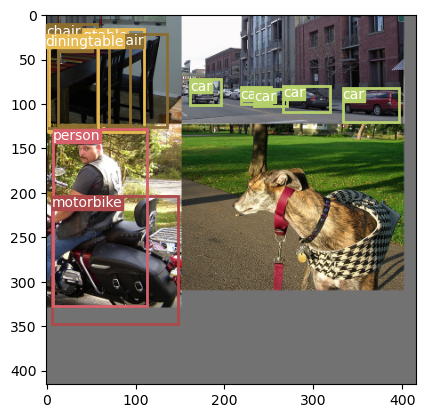

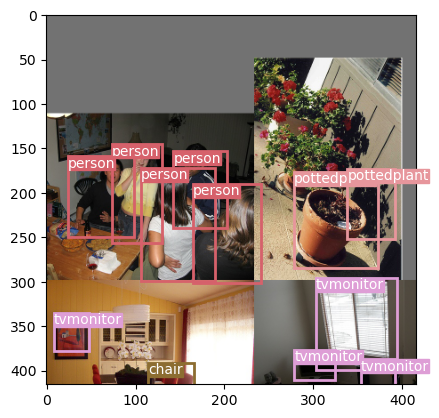

Validation: 0it [00:00, ?it/s]

Epoch: 28, Train Loss: 5.3259


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 77.878799%
No obj accuracy is: 98.101570%
Obj accuracy is: 71.675407%
Creating Checkpoint..


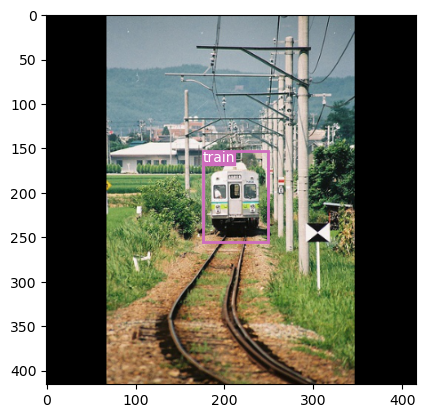

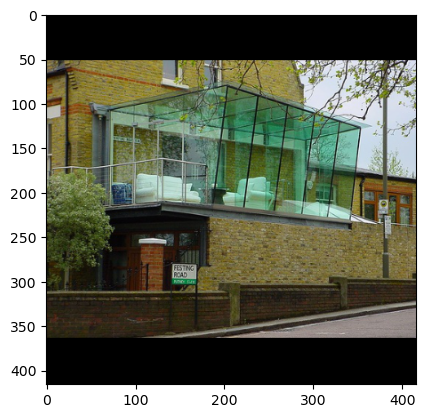

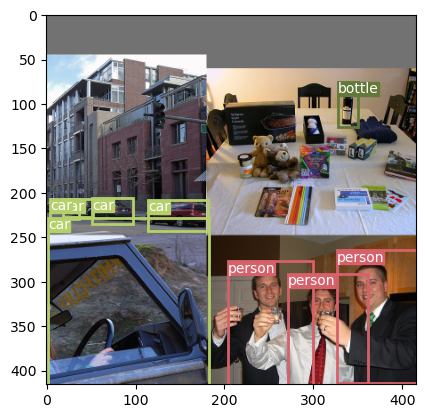

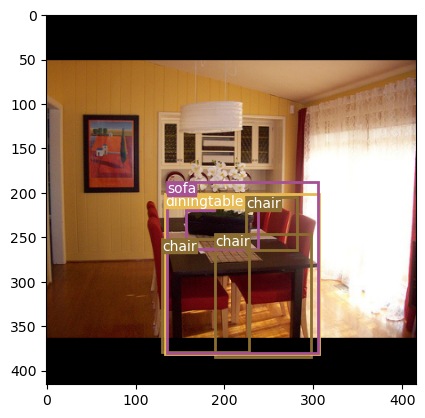

Validation: 0it [00:00, ?it/s]

Epoch: 29, Train Loss: 4.6348


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 79.028778%
No obj accuracy is: 98.013641%
Obj accuracy is: 73.421577%
Creating Checkpoint..


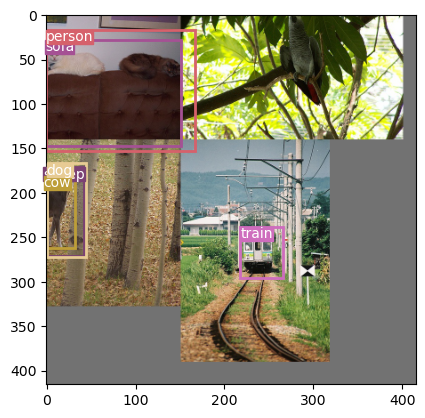

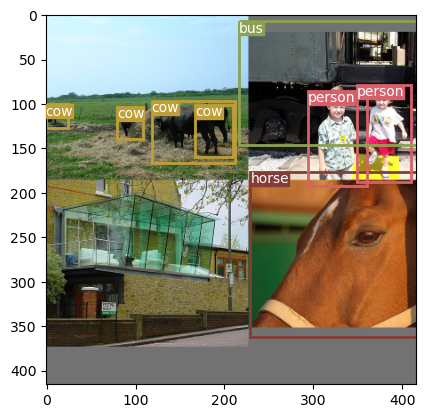

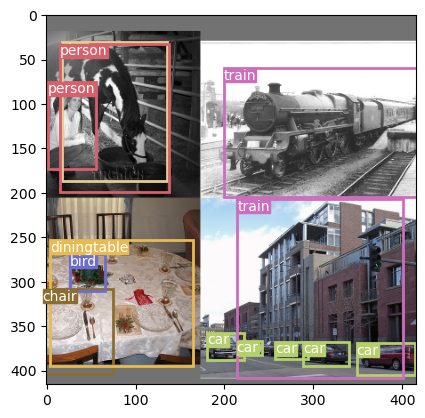

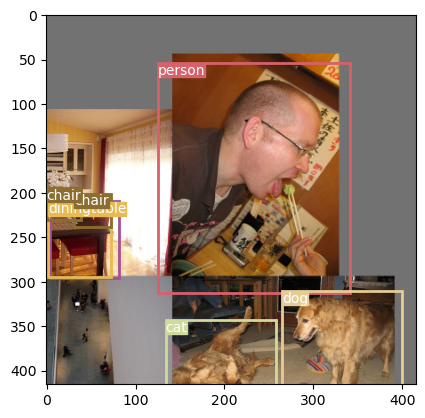

Validation: 0it [00:00, ?it/s]

Epoch: 30, Train Loss: 5.3863


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 79.023918%
No obj accuracy is: 97.860924%
Obj accuracy is: 74.716644%
Validation Loss: 6.2689


  0%|          | 0/310 [00:00<?, ?it/s]

Class accuracy is: 80.523491%
No obj accuracy is: 97.815331%
Obj accuracy is: 72.961357%
Creating Checkpoint..


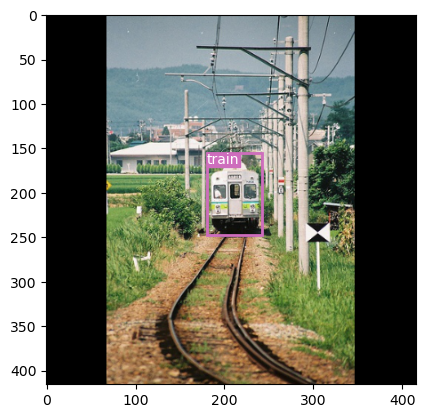

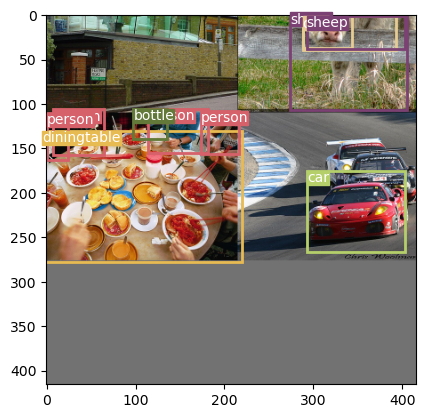

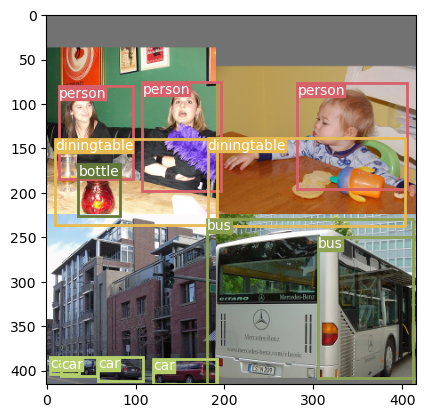

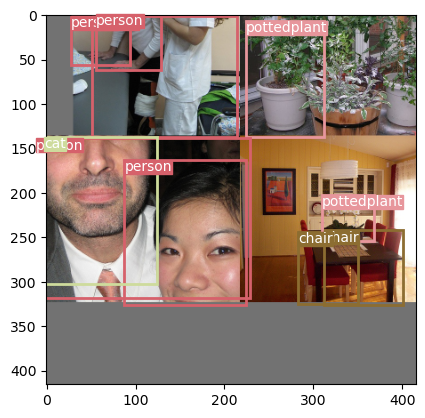

Validation: 0it [00:00, ?it/s]

Epoch: 31, Train Loss: 4.6827


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 80.152069%
No obj accuracy is: 98.103096%
Obj accuracy is: 73.900696%
Creating Checkpoint..


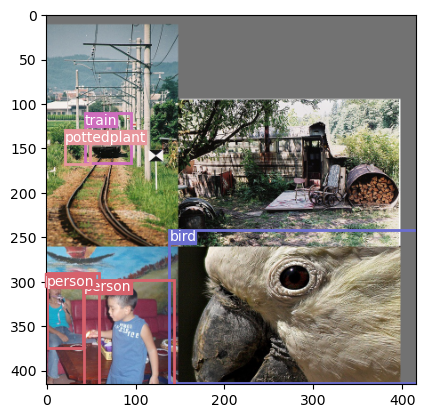

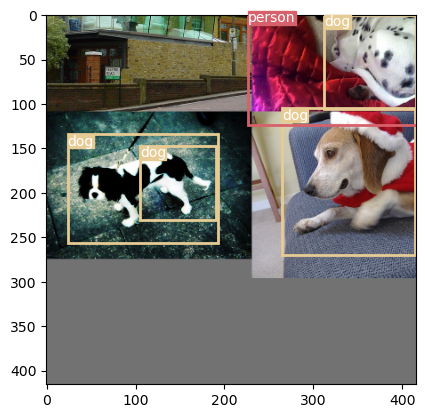

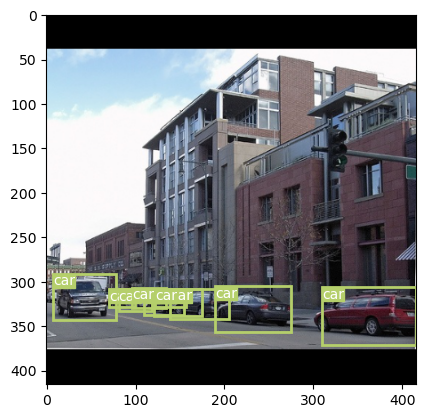

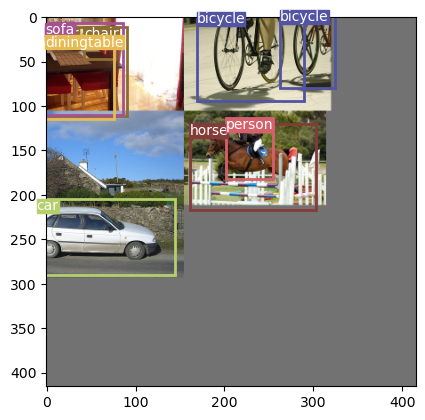

Validation: 0it [00:00, ?it/s]

Epoch: 32, Train Loss: 3.5468


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 81.437202%
No obj accuracy is: 98.175522%
Obj accuracy is: 73.781219%
Creating Checkpoint..


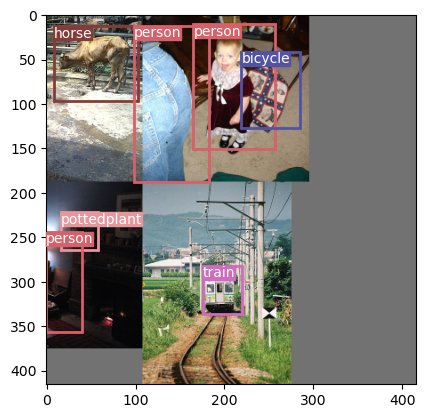

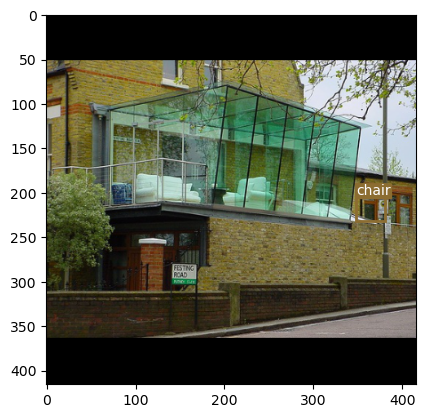

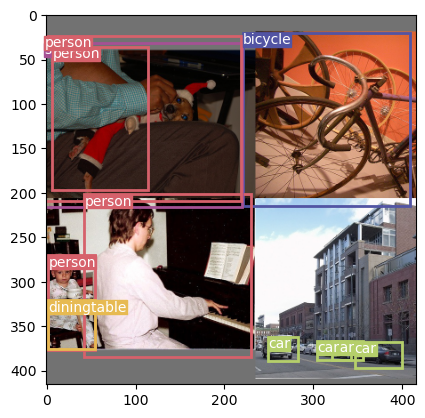

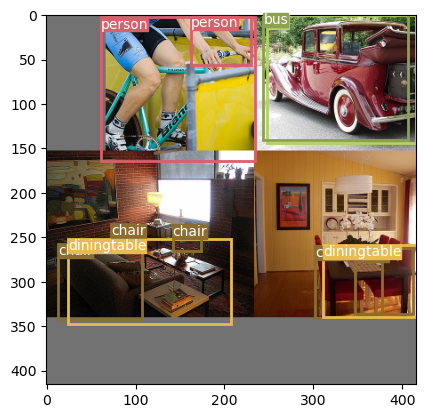

Validation: 0it [00:00, ?it/s]

Epoch: 33, Train Loss: 4.2468


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 82.156860%
No obj accuracy is: 98.044899%
Obj accuracy is: 75.779816%
Creating Checkpoint..


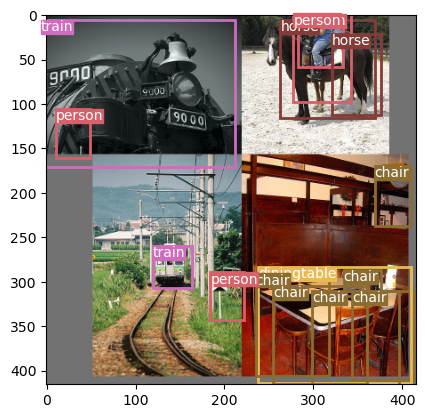

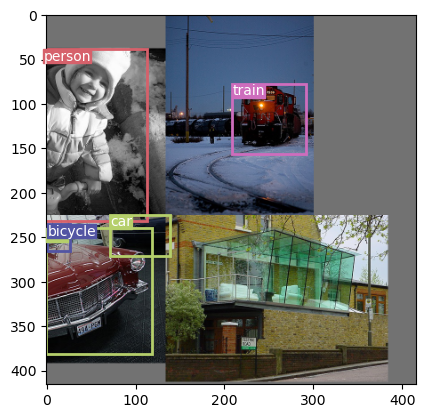

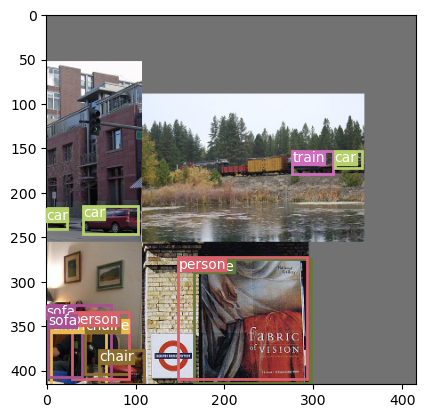

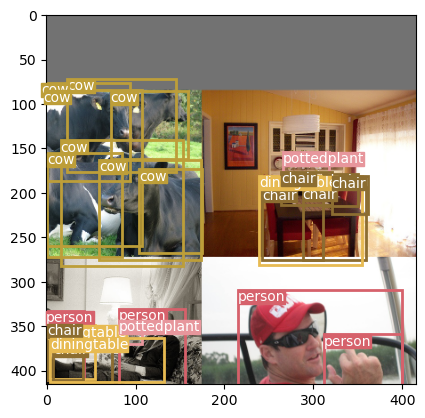

Validation: 0it [00:00, ?it/s]

Epoch: 34, Train Loss: 4.5605


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 83.017548%
No obj accuracy is: 98.013992%
Obj accuracy is: 76.313591%
Creating Checkpoint..


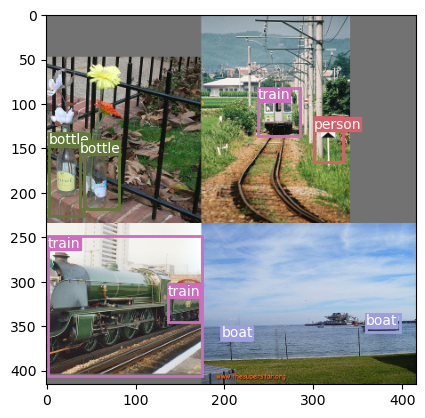

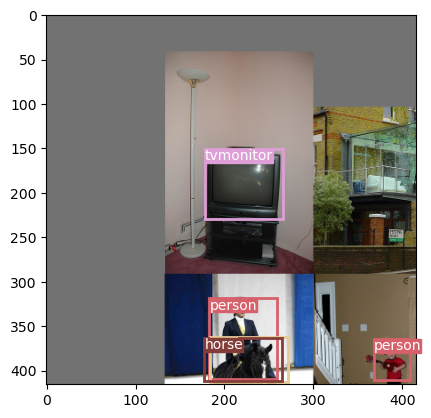

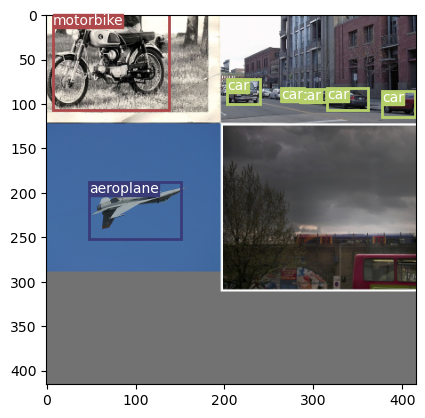

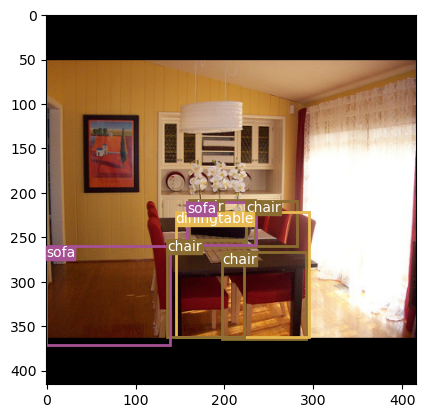

Validation: 0it [00:00, ?it/s]

Epoch: 35, Train Loss: 4.5612


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 83.639816%
No obj accuracy is: 98.145393%
Obj accuracy is: 75.969742%
Validation Loss: 6.4702


  0%|          | 0/310 [00:00<?, ?it/s]

Class accuracy is: 82.634056%
No obj accuracy is: 98.151115%
Obj accuracy is: 73.325577%
Creating Checkpoint..


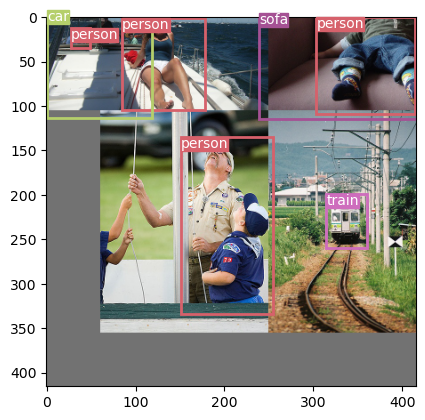

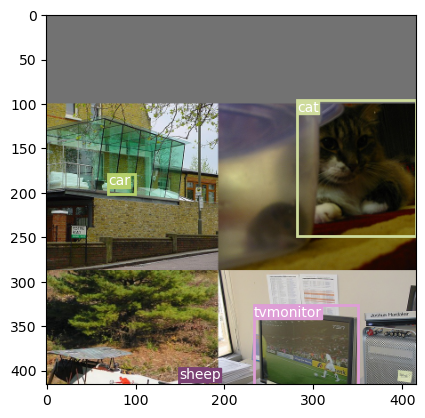

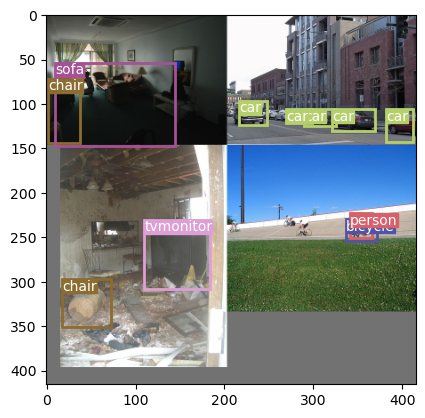

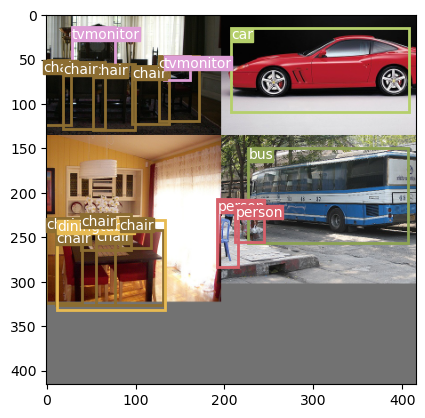

Validation: 0it [00:00, ?it/s]

Epoch: 36, Train Loss: 2.4324


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 84.300682%
No obj accuracy is: 97.974625%
Obj accuracy is: 77.838547%
Creating Checkpoint..


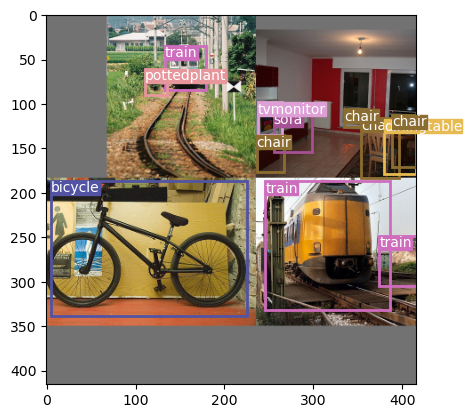

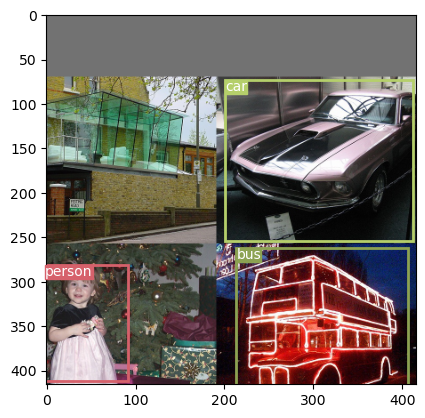

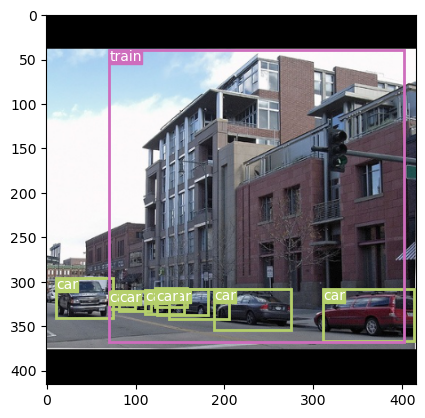

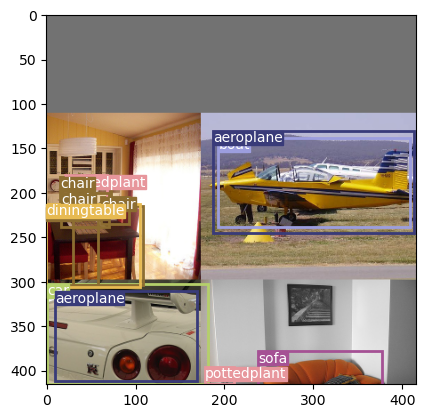

Validation: 0it [00:00, ?it/s]

Epoch: 37, Train Loss: 3.3600


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 85.017029%
No obj accuracy is: 98.161461%
Obj accuracy is: 76.889328%
Creating Checkpoint..


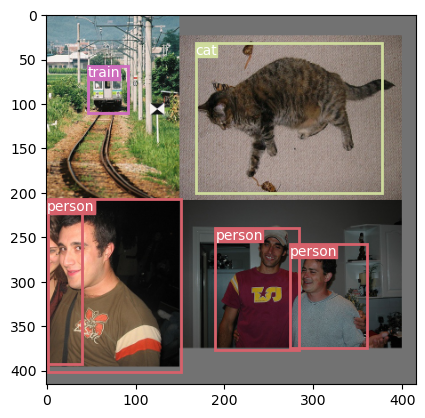

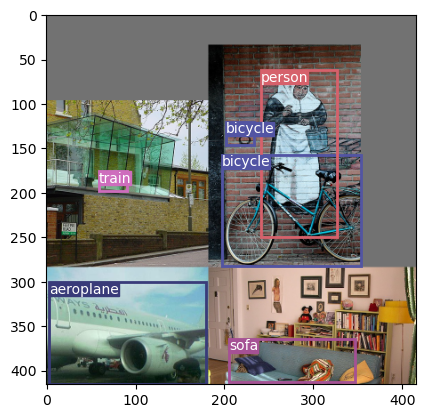

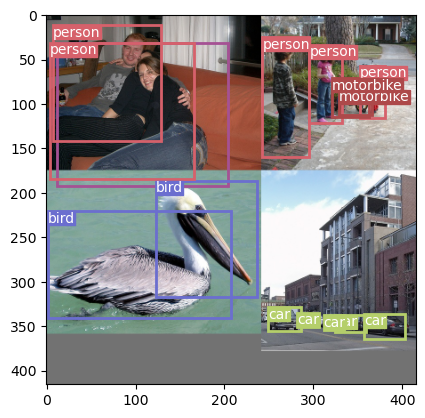

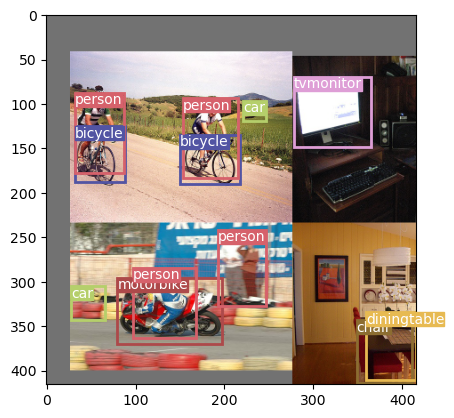

Validation: 0it [00:00, ?it/s]

Epoch: 38, Train Loss: 4.9570


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 85.670959%
No obj accuracy is: 98.124878%
Obj accuracy is: 77.508255%
Creating Checkpoint..


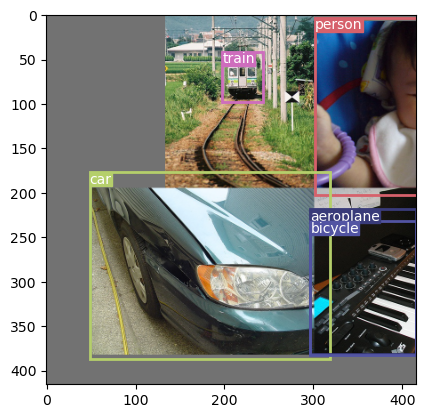

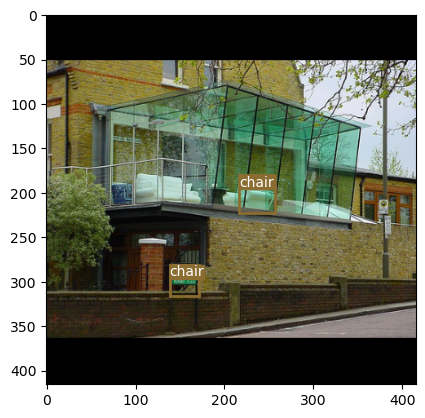

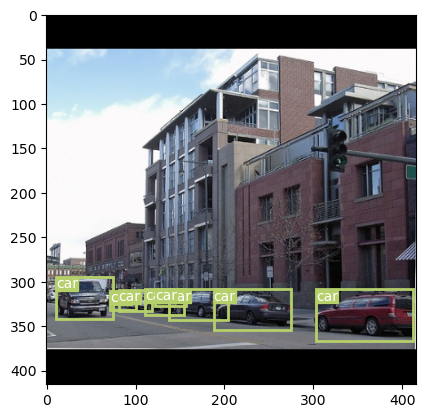

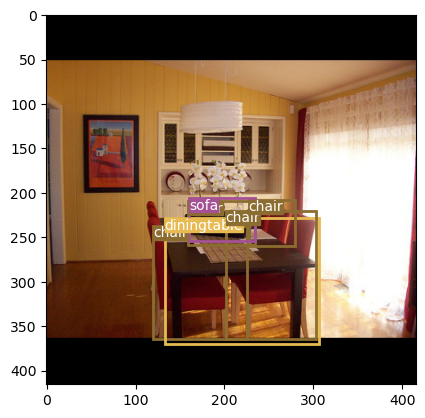

Validation: 0it [00:00, ?it/s]

Epoch: 39, Train Loss: 2.8881


  0%|          | 0/1035 [00:00<?, ?it/s]

Class accuracy is: 85.668243%
No obj accuracy is: 98.182938%
Obj accuracy is: 77.645653%
Creating Checkpoint..


`Trainer.fit` stopped: `max_epochs=40` reached.


In [9]:
### This cell has training from the 7th epoch to the 40th epoch with 
### 75% only mosaic augmentations and progress bar in single line!
trainer.fit(model, train_dataloaders=train_loader, val_dataloaders=test_loader, ckpt_path='initial_s13Model.ckpt')

In [ ]:
torch.save(trainer.model, 's13Model.pth')

In [ ]:
# start tensorboard
%load_ext tensorboard
%tensorboard --logdir lightning_logs/

In [7]:
train_loader, test_loader, train_eval_loader = get_loaders(
    train_csv_path=config.DATASET + "/train.csv", test_csv_path=config.DATASET + "/test.csv"
)

In [12]:
# # model = ResNet18()
model = s13Model(num_classes=config.NUM_CLASSES)

# # new_model = model.load_from_checkpoint('s10Model.ckpt')
model.load_state_dict(torch.load("s13Model.pth", map_location=torch.device('cuda')), strict=False)

<All keys matched successfully>

In [14]:
model = model.cuda()

In [15]:
pred_boxes, true_boxes = get_evaluation_bboxes(
    test_loader,
    model,
    iou_threshold=config.NMS_IOU_THRESH,
    anchors=config.ANCHORS,
    threshold=config.CONF_THRESHOLD,
)

mapval = mean_average_precision(
    pred_boxes,
    true_boxes,
    iou_threshold=config.MAP_IOU_THRESH,
    box_format="midpoint",
    num_classes=config.NUM_CLASSES,
)
print(f"MAP: {mapval.item()}")

  0%|          | 0/310 [00:00<?, ?it/s]

MAP: 0.5064603090286255
